# Imports

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
pd.set_option('display.max_columns', None)
sns.set_style('darkgrid')
import warnings
warnings.filterwarnings("ignore", message="`should_run_async` will not call `transform_cell` automatically")

In [22]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import plotly.graph_objects as go
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder
from sklearn.preprocessing import  StandardScaler, RobustScaler
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import KNNImputer, IterativeImputer
from sklearn.preprocessing import PowerTransformer
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, SGDRegressor, Ridge, Lasso, ElasticNet
from sklearn.metrics import r2_score,mean_absolute_error, mean_squared_error
from sklearn import set_config
import scipy.stats as stats
import statsmodels.api as sm
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from xgboost import plot_tree
from sklearn.tree import export_graphviz
import graphviz
import matplotlib.image as mpimg
import math
from scipy.stats import norm

# Helper Functions

In [ ]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
def adjusted_r2_score(y_true, y_pred, n_samples, n_features):
    r2_src = r2_score(y_true, y_pred)
    adjusted_r2 = 1 - ((1 - r2_src) * (n_samples - 1)) / (n_samples - n_features - 1)
    return adjusted_r2

def calculate_results(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)

    n_samples = len(y_true)
    n_features = y_true.shape[1] if len(y_true.shape) > 1 else 1
    adjusted_r2 = adjusted_r2_score(y_true, y_pred, n_samples, n_features)

    model_results = {"MAE": mae,
                     "MSE": mse,
                     "RMSE": rmse,
                     "R2": r2,
                     "Adjusted R2": adjusted_r2}

    return model_results

In [ ]:
! pip install mlflow

In [ ]:
def create_experiment(experiment_name, run_name, run_train_metrics, run_test_metrics, run_val_metrics, run_cross_val_score):
    import mlflow
    mlflow.set_experiment(experiment_name)

    with mlflow.start_run():
      for metric, value in run_train_metrics.items():
        mlflow.log_metric("Train_" + metric, value)

      for metric, value in run_test_metrics.items():
        mlflow.log_metric("Test_" + metric, value)

      for metric, value in run_val_metrics.items():
        mlflow.log_metric("Validation_" + metric, value)

      mlflow.log_metric("Cross-Validation Score", run_cross_val_score)

      mlflow.set_tag("tag1", experiment_name)

    print('Run - %s is logged to Experiment - %s' % (run_name, experiment_name))

# Data Loading

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
df = pd.read_csv("/content/drive/MyDrive/mumbai.csv")

In [5]:
columns = ['Address', 'Status', 'desc', 'Landmarks', 'Price_sqft']
df.drop(columns=columns, inplace=True)

# Basic Preprocessing

In [6]:
df.duplicated().sum()

7

In [7]:
df.drop_duplicates(inplace=True)
df.drop(index=3021, inplace=True)

In [8]:
rows, columns = df.shape
print("The Number of rows in dataset is:", rows)
print("The Number of columns in dataset is:", columns)

The Number of rows in dataset is: 6247
The Number of columns in dataset is: 12


In [9]:
columns = df.columns
print("We are working on features:", columns.tolist())

We are working on features: ['price', 'area', 'latitude', 'longitude', 'Bedrooms', 'Bathrooms', 'Balcony', 'neworold', 'parking', 'Furnished_status', 'Lift', 'type_of_building']


In [10]:
df.rename(columns={"Bedrooms": "bedrooms", "Bathrooms": "bathrooms", "Balcony": "balcony", "Furnished_status": "furnished_status",
                   "Lift": "lift"}, inplace=True)

In [11]:
df.sample(5)

,price,area,latitude,longitude,bedrooms,bathrooms,balcony,neworold,parking,furnished_status,lift,type_of_building
4311,41000000.0,1830.0,19.185237,72.948758,4.0,4.0,NaN,New Property,NaN,NaN,NaN,Flat
551,14000000.0,750.0,19.182497,72.941191,2.0,2.0,NaN,Resale,NaN,NaN,NaN,Flat
1498,22500000.0,1275.0,19.111327,72.901333,3.0,3.0,1.0,Resale,NaN,NaN,NaN,Individual House
4211,30000000.0,1695.0,19.153384,72.830768,3.0,3.0,3.0,Resale,1.0,NaN,NaN,Flat
6046,20000000.0,1080.0,19.129738,72.829155,3.0,2.0,NaN,Resale,NaN,Unfurnished,NaN,Individual House


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6247 entries, 0 to 6254
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   price             6247 non-null   float64
 1   area              6247 non-null   float64
 2   latitude          6247 non-null   float64
 3   longitude         6247 non-null   float64
 4   bedrooms          6247 non-null   float64
 5   bathrooms         6247 non-null   float64
 6   balcony           2373 non-null   float64
 7   neworold          6247 non-null   object 
 8   parking           2129 non-null   float64
 9   furnished_status  3597 non-null   object 
 10  lift              1678 non-null   float64
 11  type_of_building  6247 non-null   object 
dtypes: float64(9), object(3)
memory usage: 634.5+ KB


In [13]:
df.nunique()

price                540
area                 933
latitude            2465
longitude           2387
bedrooms               8
bathrooms              8
balcony                8
neworold               2
parking               44
furnished_status       3
lift                  11
type_of_building       2
dtype: int64

In [14]:
df.describe(include=['float64', 'int64'])

,price,area,latitude,longitude,bedrooms,bathrooms,balcony,parking,lift
count,6.247000e+03,6247.000000,6247.000000,6247.000000,6247.000000,6247.000000,2373.000000,2129.000000,1678.000000
mean,2.685811e+07,1185.811750,19.156692,72.868654,2.452377,2.425964,2.162242,4.662283,2.448153
std,2.790197e+07,637.253813,0.109460,0.058641,0.749809,0.762295,1.221045,35.780057,1.566455
min,1.500000e+06,503.000000,18.873713,72.754080,2.000000,2.000000,1.000000,1.000000,0.000000
25%,1.300000e+07,846.500000,19.081509,72.832931,2.000000,2.000000,1.000000,1.000000,2.000000
50%,1.900000e+07,1000.000000,19.147240,72.858019,2.000000,2.000000,2.000000,1.000000,2.000000
75%,3.000000e+07,1300.000000,19.212945,72.884691,3.000000,3.000000,3.000000,2.000000,3.000000
max,3.600000e+08,8000.000000,19.476239,73.197823,10.000000,10.000000,8.000000,801.000000,10.000000


In [15]:
df.describe(include=['object'])

,neworold,furnished_status,type_of_building
count,6247,3597,6247
unique,2,3,2
top,Resale,Unfurnished,Flat
freq,5509,1383,5821


# Data Drift Detection

In [25]:
columns_names = df.select_dtypes(exclude=['object']).columns.tolist()
columns_names = [column for column in columns_names if column not in ['price']]

In [26]:
mean_std = []
for column in columns_names:
  dictionary = {}
  dictionary['mean'] = df[column].mean()
  dictionary['std'] = df[column].std()
  mean_std.append(dictionary)

In [27]:
mean_and_std_pop = pd.DataFrame({columns_names[0]: mean_std[0], columns_names[1]: mean_std[1], columns_names[2]: mean_std[2], columns_names[3]: mean_std[3],
                             columns_names[4]: mean_std[4], columns_names[5]: mean_std[5], columns_names[6]: mean_std[6], columns_names[7]: mean_std[7]})
mean_and_std_pop

,area,latitude,longitude,bedrooms,bathrooms,balcony,parking,lift
mean,1185.811750,19.156692,72.868654,2.452377,2.425964,2.162242,4.662283,2.448153
std,637.253813,0.109460,0.058641,0.749809,0.762295,1.221045,35.780057,1.566455


In [28]:
dd_df = df.sample(30)
mean_std = []
for column in columns_names:
  dictionary = {}
  dictionary['mean'] = dd_df[column].mean()
  dictionary['std'] = dd_df[column].std()
  mean_std.append(dictionary)

In [29]:
mean_and_std_sample = pd.DataFrame({columns_names[0]: mean_std[0], columns_names[1]: mean_std[1], columns_names[2]: mean_std[2], columns_names[3]: mean_std[3],
                                   columns_names[4]: mean_std[4], columns_names[5]: mean_std[5], columns_names[6]: mean_std[6], columns_names[7]: mean_std[7]})
mean_and_std_sample

,area,latitude,longitude,bedrooms,bathrooms,balcony,parking,lift
mean,1168.533333,19.202741,72.861211,2.333333,2.400000,1.916667,6.214286,1.75000
std,599.430922,0.130407,0.069613,0.758098,0.813676,1.240112,15.748888,0.46291


In [30]:
sample_size = 30
alpha = 0.05
z_test_values = []
for i in range(len(columns_names)):
  values = {}
  values['Column'] = columns_names[i]
  values['ZScore'] = (mean_and_std_sample.iloc[0, i] - mean_and_std_pop.iloc[0, i]) / (mean_and_std_pop.iloc[1, i] / math.sqrt(sample_size))
  values['critical_z'] = abs(norm.ppf(alpha / 2))
  if abs(values['ZScore']) > values['critical_z']:
    values['Result'] = 'There is difference'
  else:
    values['Result'] = 'There is no difference'
  z_test_values.append(values)

In [31]:
Z_test_results = pd.DataFrame(z_test_values)
Z_test_results

,Column,ZScore,critical_z,Result
0,area,-0.148509,1.959964,There is no difference
1,latitude,2.304180,1.959964,There is difference
2,longitude,-0.695145,1.959964,There is no difference
3,bedrooms,-0.869595,1.959964,There is no difference
4,bathrooms,-0.186559,1.959964,There is no difference
5,balcony,-1.101573,1.959964,There is no difference
6,parking,0.237581,1.959964,There is no difference
7,lift,-2.441143,1.959964,There is difference


# Feast as a Feature Store

In [ ]:
! pip install feast

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 13.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.6/72.6 kB 8.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 37.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 28.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.8/65.8 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.5/59.5 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.4/75.4 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.6/311.6 kB 25.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.5/74.5 kB 7.1 MB/s eta 0:00:00
 

## 1) Split the data into sets of feature

In [ ]:
data_df = df.copy()

data_df1 = data_df.iloc[:, 1:4]
data_df2 = data_df.iloc[:, 4:8]
data_df3 = data_df.iloc[:, 8:]
target_df = data_df.iloc[:, 0]

## 2) Generate timestamps

In [ ]:
timestamps = pd.date_range(end=pd.Timestamp.now(),
                           periods=len(data_df),
                           freq='D').to_frame(name="event_timestamp", index=False)
timestamps

,event_timestamp
0,2006-07-10 16:33:09.182688
1,2006-07-11 16:33:09.182688
2,2006-07-12 16:33:09.182688
3,2006-07-13 16:33:09.182688
4,2006-07-14 16:33:09.182688
...,...
6242,2023-08-12 16:33:09.182688
6243,2023-08-13 16:33:09.182688
6244,2023-08-14 16:33:09.182688
6245,2023-08-15 16:33:09.182688


## 3) Join timestamps with features

In [ ]:
data_df1 = pd.concat(objs=[data_df1, timestamps], axis=1)
data_df2 = pd.concat(objs=[data_df2, timestamps], axis=1)
data_df3 = pd.concat(objs=[data_df3, timestamps], axis=1)
target_df = pd.concat(objs=[target_df, timestamps], axis=1)

## 4) Creating a unique id for each sample

In [ ]:
ids = pd.DataFrame(data=list(range(len(data_df))), columns=["ids"])

data_df1 = pd.concat(objs=[data_df1, ids], axis=1)
data_df2 = pd.concat(objs=[data_df2, ids], axis=1)
data_df3 = pd.concat(objs=[data_df3, ids], axis=1)
target_df = pd.concat(objs=[target_df, ids], axis=1)

## 5) Storing data into offline store

In [ ]:
data_df1.to_parquet(path='data_df1.parquet')
data_df2.to_parquet(path='data_df2.parquet')
data_df3.to_parquet(path='data_df3.parquet')
target_df.to_parquet(path='target_df.parquet')

## 6) Creating a Feast Repository

In [ ]:
! feast init -m house_prices

Feast is an open source project that collects anonymized error reporting and usage statistics. To opt out or learn more see https://docs.feast.dev/reference/usage
/usr/local/lib/python3.10/dist-packages/pkg_resources/__init__.py:121: DeprecationWarning: pkg_resources is deprecated as an API
  warnings.warn("pkg_resources is deprecated as an API", DeprecationWarning)
/usr/local/lib/python3.10/dist-packages/pkg_resources/__init__.py:2870: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('google')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-packages
  declare_namespace(pkg)
/usr/local/lib/python3.10/dist-packages/pkg_resources/__init__.py:2870: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('google.cloud')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferr

## 7) Features Store yml File

### Move all the data parquet file to the new data directory.

### feature_store.yaml file

In [ ]:
project: house_prices
registry: data/registry.db
provider: local
online_store:
    path: data/online_store.db
entity_key_serialization_version: 2

## 8 Define definitions

### definitions.py file

In [ ]:
from google.protobuf.duration_pb2 import Duration
from feast import Entity, Feature, FeatureView, FileSource, ValueType

# Declaring an entity for the dataset
patient = Entity(
    name="ids",
    value_type=ValueType.INT64,
    description="The ID of the records")

# Declaring the source of the first set of features
f_source1 = FileSource(
    path=r"/content/house_prices/feature_repo/data/data_df1.parquet",
    event_timestamp_column="event_timestamp"
)

# Defining the first set of features
df1_fv = FeatureView(
    name="df1_feature_view",
    ttl=Duration(seconds=86400 * 3),
    entities=["ids"],
    features=[
        Feature(name="area", dtype=ValueType.FLOAT32),
        Feature(name="latitude", dtype=ValueType.FLOAT32),
        Feature(name="longitude", dtype=ValueType.FLOAT32),
        ],
    batch_source=f_source1
)

# Declaring the source of the second set of features
f_source2 = FileSource(
    path=r"/content/house_prices/feature_repo/data/data_df2.parquet",
    event_timestamp_column="event_timestamp"
)

# Defining the second set of features
df2_fv = FeatureView(
    name="df2_feature_view",
    ttl=Duration(seconds=86400 * 3),
    entities=["ids"],
    features=[
        Feature(name="bedrooms", dtype=ValueType.FLOAT32),
        Feature(name="bathrooms", dtype=ValueType.FLOAT32),
        Feature(name="balcony", dtype=ValueType.FLOAT32),
        Feature(name="neworold", dtype=ValueType.STRING),
        ],
    batch_source=f_source2
)

# Declaring the source of the third set of features
f_source3 = FileSource(
    path=r"/content/house_prices/feature_repo/data/data_df3.parquet",
    event_timestamp_column="event_timestamp"
)

# Defining the third set of features
df3_fv = FeatureView(
    name="df3_feature_view",
    ttl=Duration(seconds=86400 * 3),
    entities=["ids"],
    features=[
        Feature(name="parking", dtype=ValueType.FLOAT32),
        Feature(name="furnished_status", dtype=ValueType.STRING),
        Feature(name="lift", dtype=ValueType.FLOAT32),
        Feature(name="type_of_building", dtype=ValueType.STRING),
        ],
    batch_source=f_source3
)


# Declaring the source of the targets
target_source = FileSource(
    path=r"/content/house_prices/feature_repo/data/target_df.parquet",
    created_timestamp_column="event_timestamp"
)

# Defining the targets
target_fv = FeatureView(
    name="target_feature_view",
    entities=["ids"],
    ttl=Duration(seconds=86400 * 3),
    features=[
        Feature(name="price", dtype=ValueType.FLOAT32)
        ],
    batch_source=target_source
)

## 9) Run Feast apply Command in terminal on feature_repo directory

In [ ]:
! feast apply

## 10) Creating create_dataset.py file inside house prices

In [ ]:
# Importing dependencies
import pandas as pd
from feast import FeatureStore
from feast.infra.offline_stores.file_source import SavedDatasetFileStorage

# Getting our FeatureStore
store = FeatureStore(repo_path="house_prices/")

# Reading our targets as an entity DataFrame
entity_df = pd.read_parquet(path="house_prices/data/target_df.parquet")

 # Getting the indicated historical features
# and joining them with our entity DataFrame
training_data = store.get_historical_features(
    entity_df=entity_df,
    features=[
        "df1_feature_view:area",
        "df1_feature_view:latitude",
        "df1_feature_view:longitude",
        "df2_feature_view:bedrooms",
        "df2_feature_view:bathrooms",
        "df2_feature_view:balcony",
        "df2_feature_view:neworold",
        "df3_feature_view:parking",
        "df3_feature_view:furnished_status",
        "df3_feature_view:lift",
        "df3_feature_view:type_of_building",
    ]
)

## 11) Storing dataset

In [ ]:
# Storing the dataset as a local file
dataset = store.create_saved_dataset(
    from_= training_data,
    name = "house_prices_dataset",
    storage = SavedDatasetFileStorage("/content/house_prices/feature_repo/data/house_prices_dataset.parquet")
)

## 12) Getting dataset for training

In [ ]:
# Importing dependencies
from feast import FeatureStore

In [ ]:
# Getting our FeatureStore
store = FeatureStore(repo_path="/content/house_prices/")

In [ ]:
# Retrieving the saved dataset and converting it to a DataFrame
training_df = store.get_saved_dataset(name="house_prices_dataset").to_df()

# Separating the features and labels
labels = training_df['price']
features = training_df.drop(
    labels=['price', 'event_timestamp', "ids"],
    axis=1)

## 13) Getting features for prediction

In [ ]:
# Importing dependencies
from feast import FeatureStore
from datetime import datetime, timedelta

# Getting our FeatureStore
store = FeatureStore(repo_path="/content/house_prices/")

# Code for loading features to online store between two dates
"""store.materialize(
    end_date=datetime.now(),
    start_date=datetime.now() - timedelta(days=700))"""

# Loading the latest features after a previous materialize call or from the beginning of time
store.materialize_incremental(end_date=datetime.now())

In [ ]:
# Importing dependencies
from feast import FeatureStore
import pandas as pd
from joblib import load

# Getting our FeatureStore
store = FeatureStore(repo_path="/content/customer_churn/")

feast_features = [
    "df1_feature_view:area",
    "df1_feature_view:latitude",
    "df1_feature_view:longitude",
    "df2_feature_view:bedrooms",
    "df2_feature_view:bathrooms",
    "df2_feature_view:balcony",
    "df2_feature_view:neworold",
    "df3_feature_view:parking",
    "df3_feature_view:furnished_status",
    "df3_feature_view:lift",
    "df3_feature_view:type_of_building",
]

# Getting the latest features
features = store.get_online_features(
    features=feast_features,
    entity_rows=[{"ids": 1002}, {"ids": 1004}]
).to_dict()

features_df = pd.DataFrame.from_dict(data=features)

In [ ]:
! cp -r /content/house_prices /content/drive/MyDrive/House_Price_Predictions

# Feature Creation

In [ ]:
df['bedrooms'] = df['bedrooms'].apply(lambda row: 5.0 if row >= 5.0 else row)
df['bathrooms'] = df['bathrooms'].apply(lambda row: 5.0 if row >= 5.0 else row)
df['balcony'] = df['balcony'].apply(lambda row: 6.0 if row >= 6 else row)
df['parking'] = df['parking'].apply(lambda row: 4.0 if row >= 4.0 else row)
df['lift'] = df['lift'].apply(lambda row: 5.0 if row >= 5.0 else row)

In [ ]:
df['Total_Rooms'] = df['bedrooms'] + df['bathrooms']
df['Approx_Avg_Area_Per_Room'] = df['area'] / df['Total_Rooms']
df['Balcony_Ratio'] = df['balcony'] / df['bedrooms']
df['Bathroom_Ratio'] = df['bathrooms'] / df['bedrooms']

In [ ]:
Hospital = {"PD Hinduja Hospital": [19.0332, 72.8391], "Lilavati Hospital": [19.0509, 72.8289], "Breach Candy Hospital": [18.9725, 72.8046],
              "Wockhardt Hospital": [18.9759, 72.8244], "KEM Hospital": [19.0013, 72.8406], "JJ Hospital": [18.9631, 72.8336],
              "Nair Hospital": [18.9727, 72.8212], "SevenHills Hospital": [19.1175, 72.8795], "Nanavati Super Speciality Hospital": [19.0957, 72.8402],
              "Kokilaben Dhirubhai Ambani Hospital": [19.1312, 72.8248]}

In [ ]:
Schools = {"St Xavier": [19.1359, 72.9289], "Bombay Scottish": [19.0337, 72.8388], "Don Bosco": [19.0259, 72.8584],
           "Hansraj Morarji Public School": [19.11654, 72.82825], "St Anne":[19.19405, 72.8379]}

In [ ]:
Collages = {"KJ.Somaiya College": [19.0723, 72.9002], "Mithibai College": [19.1034, 72.8369], "Ruia College": [19.0237, 72.8502],
            "Jai Hind College": [18.9346, 72.8252], "Narsee Monjee College": [19.10390, 72.8370]}

In [ ]:
Street = {"Fashion Street": [19.076, 72.8777], "Bandra Linking Road": [19.0615, 72.8359], "Bandra Hill Road": [19.0555, 72.8322],
         "Colaba Causeway": [18.9218, 72.8347], "Crawford Market": [18.9463, 72.8352], "Malad West": [19.1827, 72.8401],
         "Natraj Market": [19.1152, 72.853], "Hindmata": [19.0062, 72.8405], "Grant Road": [18.9629, 72.81757],
         "Infiniti Mall": [19.1846, 72.8344], "RCity Mall": [19.0996, 72.9162], "Phoenix Marketcity": [19.0865, 72.8888], "Growel Mall": [19.2032, 72.8599] }

In [ ]:
Areas = {"South Mumbai": [19.0197, 72.8515], "Bandra": [19.0548, 72.8407], "Juhu": [19.0884, 72.8265], "Powai": [19.1176, 72.906],
         "BKC": [19.0688, 72.8703], "Worli": [18.9986, 72.8174], "Lower Parel": [18.9982, 72.8270], "Andheri West": [19.1364, 72.8296],
         "Goregaon East": [19.1663, 72.8526], "Thane": [19.2183, 72.9781]}

In [ ]:
import math
# It will return the distance in km
def haversine_distance(lat1, lon1, lat2, lon2):
  # Convert degree into radian
  lat1_rad = math.radians(lat1)
  lon1_rad = math.radians(lon1)
  lat2_rad = math.radians(lat2)
  lon2_rad = math.radians(lon2)

  dlat = lat2_rad - lat1_rad
  dlon = lon2_rad - lon1_rad
  a = math.sin(dlat/2)**2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon/2)**2
  c = 2 * math.atan2(math.sqrt(a), math.sqrt(1-a))
  R = 6371 # Radius of earth in km
  distance = R * c
  return distance

In [ ]:
for key, value in Hospital.items():
  latitude, longitude = value
  df[key] = df.apply(lambda row: haversine_distance(row['latitude'], row['longitude'], latitude, longitude), axis=1)

In [ ]:
for key, value in Schools.items():
  latitude, longitude = value
  df[key] = df.apply(lambda row: haversine_distance(row['latitude'], row['longitude'], latitude, longitude), axis=1)

In [ ]:
for key, value in Collages.items():
  latitude, longitude = value
  df[key] = df.apply(lambda row: haversine_distance(row['latitude'], row['longitude'], latitude, longitude), axis=1)

In [ ]:
for key, value in Street.items():
  latitude, longitude = value
  df[key] = df.apply(lambda row: haversine_distance(row['latitude'], row['longitude'], latitude, longitude), axis=1)

In [ ]:
for key, value in Areas.items():
  latitude, longitude = value
  df[key] = df.apply(lambda row: haversine_distance(row['latitude'], row['longitude'], latitude, longitude), axis=1)

In [ ]:
df.sample(5)

,price,area,latitude,longitude,bedrooms,bathrooms,balcony,neworold,parking,furnished_status,lift,type_of_building,Total_Rooms,Approx_Avg_Area_Per_Room,Balcony_Ratio,Bathroom_Ratio,PD Hinduja Hospital,Lilavati Hospital,Breach Candy Hospital,Wockhardt Hospital,KEM Hospital,JJ Hospital,Nair Hospital,SevenHills Hospital,Nanavati Super Speciality Hospital,Kokilaben Dhirubhai Ambani Hospital,St Xavier,Bombay Scottish,Don Bosco,Hansraj Morarji Public School,St Anne,KJ.Somaiya College,Mithibai College,Ruia College,Jai Hind College,Narsee Monjee College,Fashion Street,Bandra Linking Road,Bandra Hill Road,Colaba Causeway,Crawford Market,Malad West,Natraj Market,Hindmata,Grant Road,Infiniti Mall,RCity Mall,Phoenix Marketcity,Growel Mall,South Mumbai,Bandra,Juhu,Powai,BKC,Worli,Lower Parel,Andheri West,Goregaon East,Thane
6249,11500000.0,550.0,19.079069,72.907974,2.0,2.0,NaN,New Property,NaN,Unfurnished,NaN,Flat,4.0,137.5,NaN,1.0,8.855174,8.881062,16.078173,14.449404,11.177289,15.080263,14.936566,5.216591,7.357998,10.486856,6.690862,8.849146,7.880483,9.356000,14.753054,1.110863,7.943350,8.647480,18.269895,7.952592,3.199705,7.822333,8.383603,19.109219,16.627881,13.550944,7.036198,10.768140,16.036784,14.051305,2.441083,2.177754,14.697563,8.877706,7.567664,8.624266,4.289455,4.120565,13.065286,12.381609,10.413894,11.310478,17.144847
2852,12600000.0,860.0,19.032800,72.896357,2.0,2.0,NaN,Resale,NaN,Semi-Furnished,NaN,Flat,4.0,215.0,NaN,1.0,6.018770,7.370535,11.748158,9.862110,6.828272,10.178488,10.348672,9.583404,9.151554,13.276395,11.963425,6.050960,4.063045,11.744417,18.952948,4.410779,10.033599,4.956338,13.236706,10.070640,5.188471,7.110801,7.200388,13.941757,11.569787,17.685177,10.232888,6.574776,11.359045,18.091190,7.715061,6.023798,19.330919,4.935212,6.340939,9.598218,9.483674,4.850252,9.130145,8.244055,13.487670,15.540269,22.343002
3571,11000000.0,1500.0,19.454059,72.768823,2.0,2.0,NaN,Resale,1.0,Unfurnished,NaN,Flat,4.0,375.0,NaN,1.0,47.375370,45.270660,53.678511,53.488122,50.905390,55.014235,53.806461,39.184978,40.545852,36.377776,39.163963,47.315550,48.529001,38.045132,29.806410,44.633532,39.640782,48.610363,58.063801,39.587990,43.564044,44.214817,44.814312,59.587454,56.888828,31.086898,38.701302,50.365016,54.853713,30.742482,42.340866,42.766873,29.485840,49.072257,45.032176,41.107647,40.087177,44.143317,50.900876,51.055889,35.893348,33.183120,34.196285
2897,18500000.0,896.0,19.125799,72.844848,2.0,2.0,NaN,Resale,NaN,Unfurnished,NaN,Flat,4.0,224.0,NaN,1.0,10.314261,8.495334,17.563153,16.806012,13.850875,18.129912,17.204340,3.755714,3.382313,2.190056,8.901179,10.260664,11.199212,2.025012,7.624147,8.319601,2.626921,11.366839,21.360461,2.570878,6.525228,7.211298,7.929086,22.708745,19.985146,6.346702,1.456924,13.306671,18.339072,6.629805,8.042819,6.357851,8.750582,11.818388,7.906772,4.583693,6.489022,6.879173,14.435076,14.311835,1.988790,4.576518,17.368342
4596,33000000.0,960.0,19.108240,72.842600,3.0,3.0,NaN,Resale,1.0,Furnished,NaN,Flat,6.0,160.0,NaN,1.0,8.352171,6.536437,15.613155,14.839360,11.893043,16.166535,15.238294,4.011315,1.417004,3.164682,9.574106,8.298085,9.305145,1.767742,9.554400,7.252905,0.805183,9.434291,19.394336,0.760981,5.143434,5.244722,5.965385,20.747811,18.023701,8.283738,1.338997,11.348477,16.373834,8.534423,7.792677,5.423065,10.714291,9.889532,5.945610,2.780065,6.741961,5.263578,12.475800,12.345255,3.416146,6.540886,18.770227


# Numerical and Categorical columns

In [ ]:
numerical_columns = df.select_dtypes(exclude=['object']).columns.tolist()
categorical_columns = df.select_dtypes(include=['object']).columns.tolist()
print("Total Number of Numerical Columns:", len(numerical_columns))
print("Total Number of Categorical Columns:", len(categorical_columns))

Total Number of Numerical Columns: 56
Total Number of Categorical Columns: 3


# Handle Outlier

In [ ]:
for column in numerical_columns:
  percentile25 = df[column].quantile(0.25)
  percentile75 = df[column].quantile(0.75)
  IQR = percentile75 - percentile25
  lower_limit = percentile25 - 1.5 * IQR
  upper_limit = percentile75 + 1.5 * IQR
  df[column] = np.where(df[column] > upper_limit,
                        upper_limit,
                        np.where(
                            df[column] < lower_limit,
                            lower_limit,
                            df[column]))

# Missing Data Analysis

In [ ]:
df.isnull().sum()

price                                     0
area                                      0
latitude                                  0
longitude                                 0
bedrooms                                  0
bathrooms                                 0
balcony                                3874
neworold                                  0
parking                                4118
furnished_status                       2650
lift                                   4569
type_of_building                          0
Total_Rooms                               0
Approx_Avg_Area_Per_Room                  0
Balcony_Ratio                          3874
Bathroom_Ratio                            0
PD Hinduja Hospital                       0
Lilavati Hospital                         0
Breach Candy Hospital                     0
Wockhardt Hospital                        0
KEM Hospital                              0
JJ Hospital                               0
Nair Hospital                   

In [ ]:
Missing_data = pd.DataFrame({'Missing count': df.isnull().sum(), 'Missing Percentage': (df.isnull().sum()/df.shape[0])*100})
Missing_data

,Missing count,Missing Percentage
price,0,0.000000
area,0,0.000000
latitude,0,0.000000
longitude,0,0.000000
bedrooms,0,0.000000
bathrooms,0,0.000000
balcony,3874,62.013767
neworold,0,0.000000
parking,4118,65.919641
furnished_status,2650,42.420362


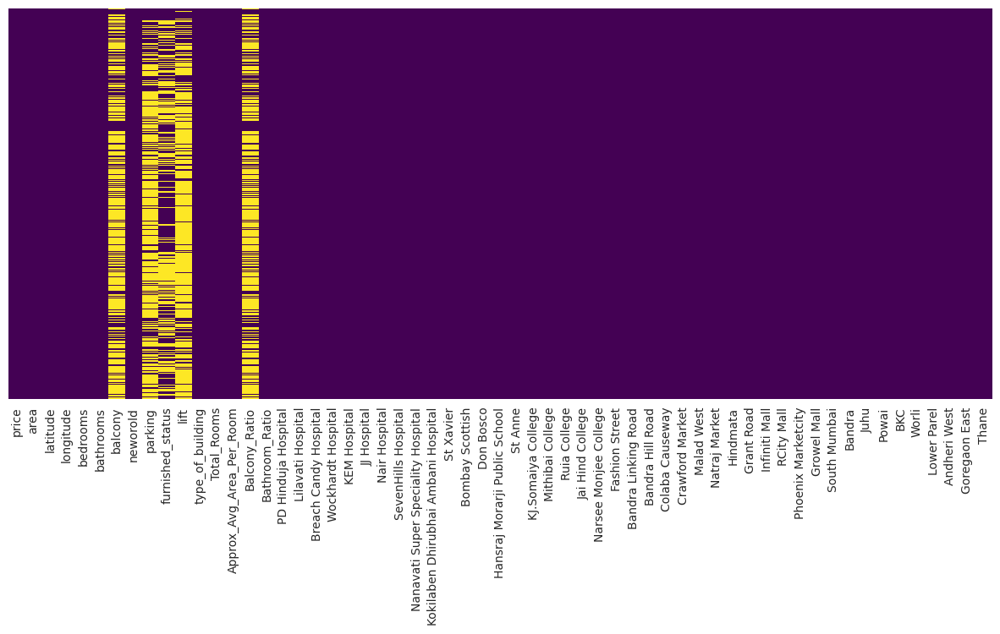

In [ ]:
plt.figure(figsize=(15, 6))
sns.heatmap(df.isnull(), yticklabels=False, cbar=False, cmap='viridis');

In [ ]:
df['furnished_status'].fillna("Not-Specified", inplace=True)

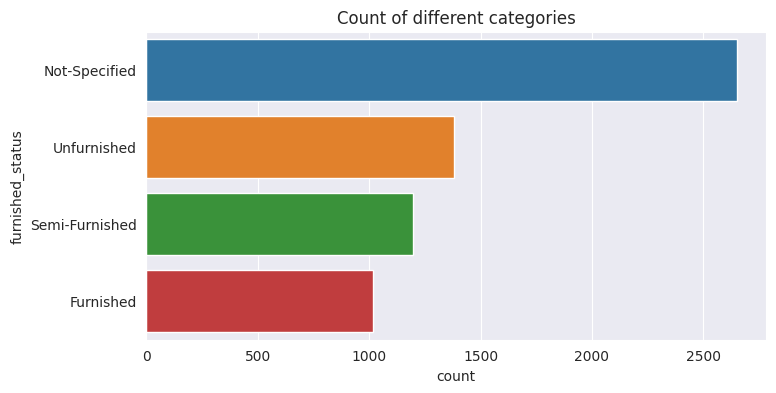

In [ ]:
plt.figure(figsize=(8, 4))
plt.title("Count of different categories")
sns.countplot(y='furnished_status', data=df);

# Statistics

In [ ]:
def cofficient_of_variation(column):
  mean = column.mean()
  std_dev = column.std()
  return (std_dev / mean) * 100

In [ ]:
cv_data = {col: cofficient_of_variation(df[col]) for col in numerical_columns}
cv_df = pd.DataFrame(cv_data, index=['Coefficient of Variation'])
cv_df.head()

,price,area,latitude,longitude,bedrooms,bathrooms,balcony,parking,lift,Total_Rooms,Approx_Avg_Area_Per_Room,Balcony_Ratio,Bathroom_Ratio,PD Hinduja Hospital,Lilavati Hospital,Breach Candy Hospital,Wockhardt Hospital,KEM Hospital,JJ Hospital,Nair Hospital,SevenHills Hospital,Nanavati Super Speciality Hospital,Kokilaben Dhirubhai Ambani Hospital,St Xavier,Bombay Scottish,Don Bosco,Hansraj Morarji Public School,St Anne,KJ.Somaiya College,Mithibai College,Ruia College,Jai Hind College,Narsee Monjee College,Fashion Street,Bandra Linking Road,Bandra Hill Road,Colaba Causeway,Crawford Market,Malad West,Natraj Market,Hindmata,Grant Road,Infiniti Mall,RCity Mall,Phoenix Marketcity,Growel Mall,South Mumbai,Bandra,Juhu,Powai,BKC,Worli,Lower Parel,Andheri West,Goregaon East,Thane
Coefficient of Variation,62.896437,34.605926,0.548493,0.057325,27.054241,28.004055,55.595327,49.984203,48.539356,26.849443,23.61538,57.578781,0.0,62.904786,62.025282,50.318324,53.2821,58.850551,51.280853,52.478528,64.430735,63.80371,60.147674,53.122332,62.926704,63.448383,61.318159,64.404293,63.067966,62.487702,63.014765,45.707466,62.523597,67.259441,64.079484,62.969453,43.870124,48.221061,65.148868,64.462346,59.732823,50.507382,64.417918,59.136523,65.378167,64.345737,62.391667,63.810135,60.187576,59.578466,67.554655,56.012993,57.200916,62.795374,65.306068,37.336981


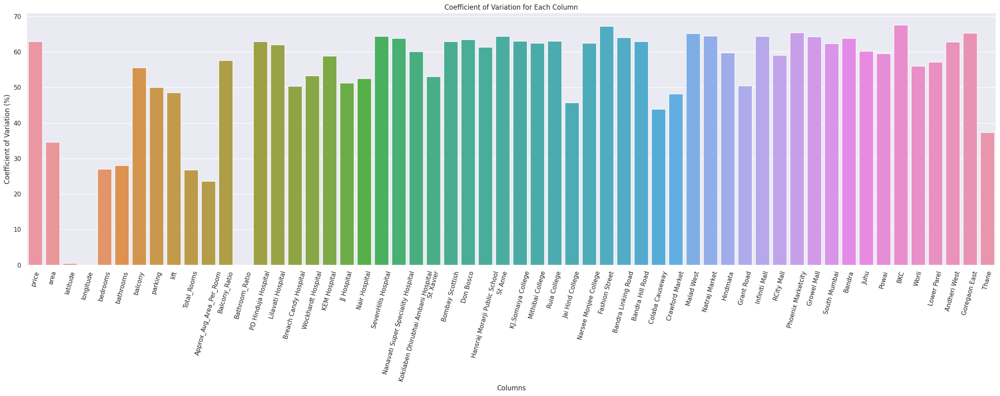

In [ ]:
plt.figure(figsize=(25, 10))
sns.barplot(data=cv_df)
plt.title("Coefficient of Variation for Each Column")
plt.xlabel('Columns')
plt.ylabel('Coefficient of Variation (%)')
plt.xticks(rotation=75)
plt.tight_layout();

In [ ]:
skewness_data = df.skew()

print("Skewness Classification:")
skewness_classification = []
for skew_value in skewness_data:
  if skew_value > 0.5 and skew_value < 1:
    skew_type = "Right Skew"
  elif skew_value > -0.5 and skew_value < 0.5:
    skew_type = "Almost Symmetrical"
  elif skew_value < -0.5:
    skew_type = "Left Skew"
  skewness_classification.append(skew_type)

Skewness Classification:


<ipython-input-361-5ab851ba54a5>:1: FutureWarning:

The default value of numeric_only in DataFrame.skew is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



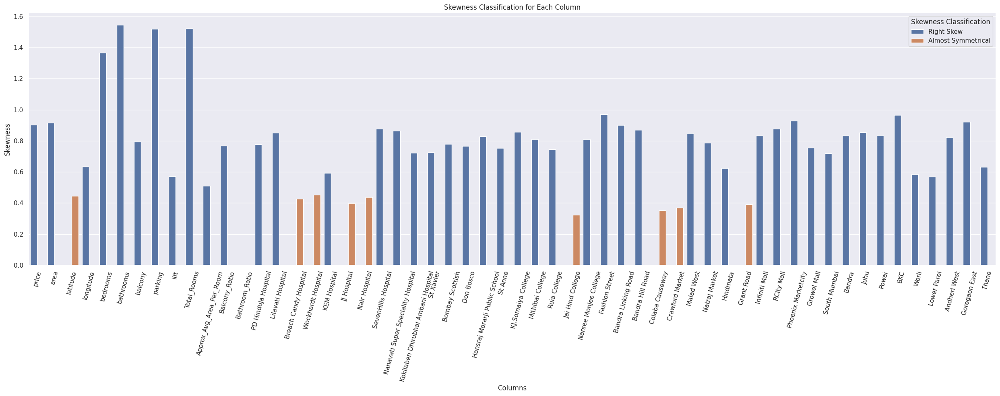

In [ ]:
plt.figure(figsize=(25, 10))
sns.barplot(x=skewness_data.index.tolist(), y=skewness_data.values.tolist(), hue=skewness_classification)
plt.title('Skewness Classification for Each Column')
plt.xlabel('Columns')
plt.ylabel('Skewness')
plt.xticks(rotation=75)
plt.tight_layout()
plt.legend(title="Skewness Classification");

In [ ]:
from scipy.stats import kurtosis
kurtosis_data = kurtosis(df[numerical_columns])

print("Kurtosis Classification:")
kurtosis_classification = []
for value in kurtosis_data:
  if value > 0:
    type_ = "Peaked"
  elif value < 0:
    type_ = "Flat"
  else:
    type_ = "Similar to Normal"
  kurtosis_classification.append(type_)

Kurtosis Classification:


/usr/local/lib/python3.10/dist-packages/numpy/lib/shape_base.py:402: RuntimeWarning:

Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.



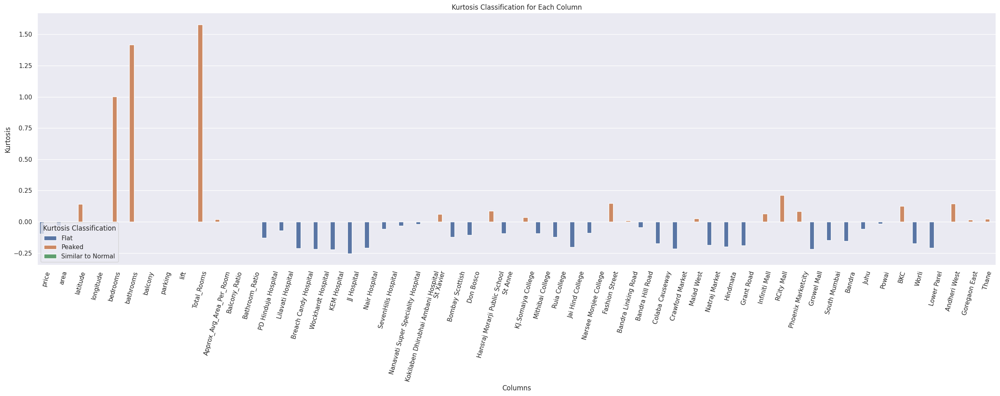

In [ ]:
plt.figure(figsize=(25, 10))
sns.barplot(x=numerical_columns, y=kurtosis_data.tolist(), hue=kurtosis_classification)
plt.title('Kurtosis Classification for Each Column')
plt.xlabel('Columns')
plt.ylabel('Kurtosis')
plt.xticks(rotation=75)
plt.tight_layout()
plt.legend(title="Kurtosis Classification");

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



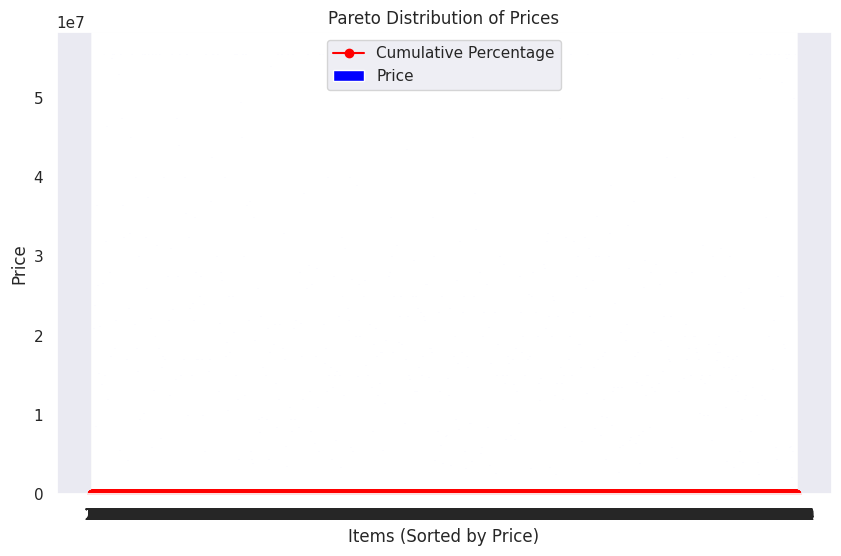

In [ ]:
df_sorted = df[['price']].sort_values(by="price", ascending=False)

total_sum = df_sorted["price"].sum()
df_sorted["cum_percentage"] = df_sorted["price"].cumsum() / total_sum * 100

plt.figure(figsize=(10, 6))
plt.bar(df_sorted.index, df_sorted["price"], color='blue')
plt.plot(df_sorted.index, df_sorted["cum_percentage"], color='red', marker='o')
plt.xlabel('Items (Sorted by Price)')
plt.ylabel('Price')
plt.title('Pareto Distribution of Prices')
plt.xticks(df_sorted.index, df_sorted.index)
plt.legend(["Cumulative Percentage", "Price"])
plt.grid(axis='y')
plt.show()

# Data Visulization

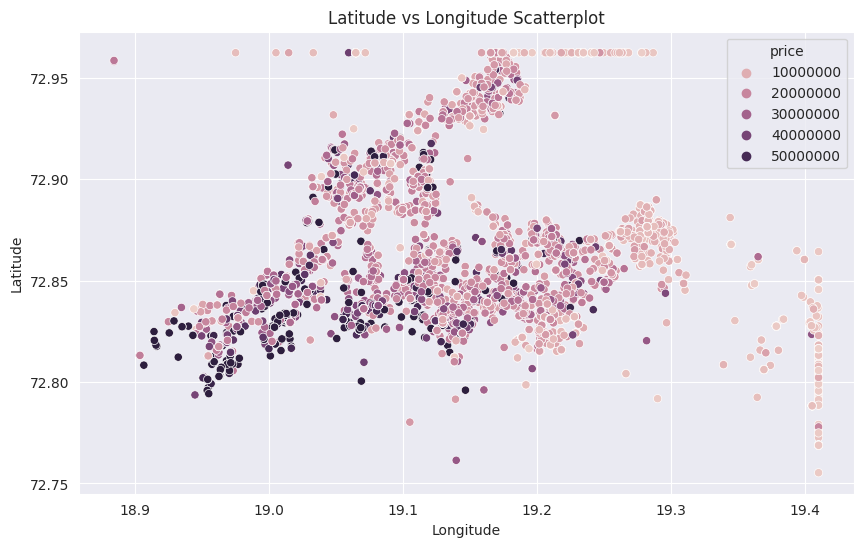

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['latitude'], y=df['longitude'], hue=df['price'])
plt.title('Latitude vs Longitude Scatterplot')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

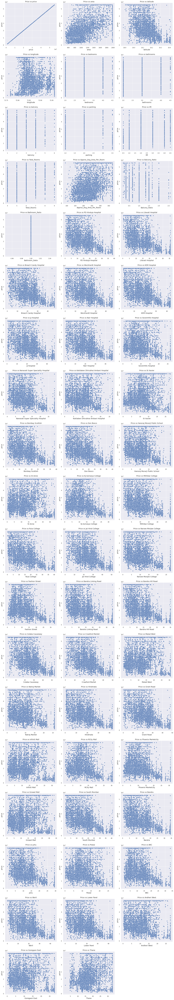

In [ ]:
num_rows = (len(numerical_columns) + 2) // 3
num_cols = 3
plt.figure(figsize=(20, 6 * num_rows))

for i, column in enumerate(numerical_columns):
    plt.subplot(num_rows, num_cols, i+1)
    sns.scatterplot(x=df[column], y=df['price'])
    plt.title("Price vs {}".format(column), fontsize=14)
    plt.xlabel(column, fontsize=14)
    plt.ylabel("price", fontsize=14)

plt.tight_layout()
plt.show()

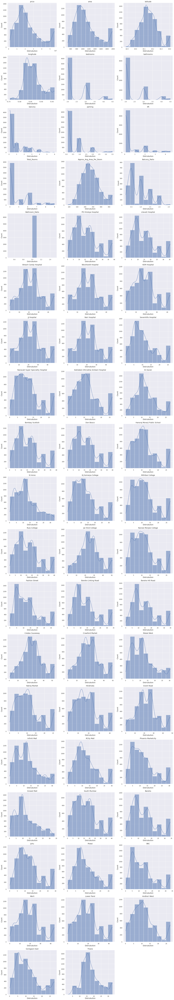

In [ ]:
num_rows = (len(numerical_columns) + 2) // 3
num_cols = 3
plt.figure(figsize=(20, 6 * num_rows))

for i, column in enumerate(numerical_columns):
    if column in ['balcony', 'parking', 'lift']:
      plt.subplot(num_rows, num_cols, i+1)
      sns.histplot(x=df[column].fillna(0.1), bins=10, kde=True)
      plt.title(column, fontsize=14)
      plt.xlabel("Distrubution", fontsize=14)
      plt.ylabel("Count", fontsize=14)
    else:
      plt.subplot(num_rows, num_cols, i+1)
      sns.histplot(x=df[column], bins=10, kde=True)
      plt.title(column, fontsize=14)
      plt.xlabel("Distrubution", fontsize=14)
      plt.ylabel("Count", fontsize=14)

plt.tight_layout()
plt.show()

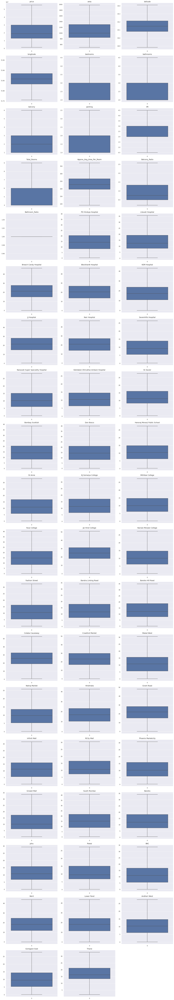

In [ ]:
num_rows = (len(numerical_columns) + 2) // 3
num_cols = 3
plt.figure(figsize=(20, 6 * num_rows))

for i, column in enumerate(numerical_columns):
  plt.subplot(num_rows, num_cols, i+1)
  sns.boxplot(data=df[column])
  plt.title(column, fontsize=14)

plt.tight_layout()
plt.show()

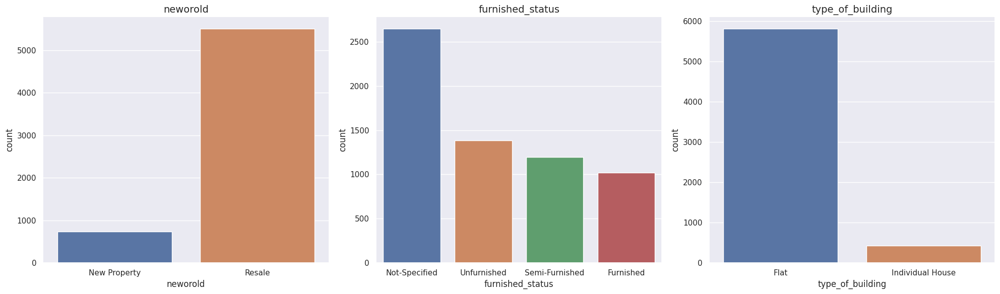

In [ ]:
num_rows = (len(categorical_columns) + 2) // 3
num_cols = 3
plt.figure(figsize=(20, 6 * num_rows))

for i, column in enumerate(categorical_columns):
  plt.subplot(num_rows, num_cols, i+1)
  sns.countplot(x=column, data=df)
  plt.title(column, fontsize=14)

plt.tight_layout()
plt.show()

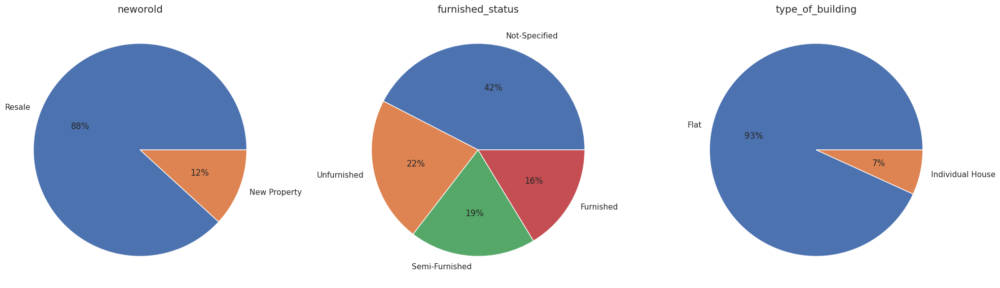

In [ ]:
num_rows = (len(categorical_columns) + 2) // 3
num_cols = 3
plt.figure(figsize=(20, 6 * num_rows))

for i, column in enumerate(categorical_columns):
  plt.subplot(num_rows, num_cols, i+1)
  palette_color = sns.color_palette('bright')
  plt.pie(x=df[column].value_counts() / df.shape[0] * 100, labels=df[column].value_counts().index.tolist(), autopct="%.0f%%")
  plt.title(column, fontsize=14)

plt.tight_layout()
plt.show()

In [ ]:
pca = PCA(n_components=2, random_state=42)
embedded_data = pca.fit_transform(df.drop(columns = ['neworold', 'furnished_status', 'balcony',  'type_of_building', 'parking', 'lift']).fillna(0.1))


fig = px.scatter(df, x=embedded_data[:, 0], y=embedded_data[:, 1], color=df['price'])
fig.update_layout(
    title='PCA Visulization',
    xaxis=dict(title='Dimension 1'),
    yaxis=dict(title='Dimension 2'),
    width=800,
    height=600,
)

fig.show()

In [ ]:
correlation_matrix = df.corr(numeric_only=True)

fig = go.Figure(data=go.Heatmap(
    z=correlation_matrix.values,
    x=correlation_matrix.columns,
    y=correlation_matrix.index,
    colorscale='RdBu',
    colorbar=dict(title='Correlation'),
))

fig.update_layout(
    title='Correlation Matrix',
    xaxis=dict(title='Feature'),
    yaxis=dict(title='Feature'),
    xaxis_tickangle=-45,
    width=800,
    height=800
)

fig.show()

In [ ]:
correlation_matrix['price'].sort_values(ascending=False)

price                                  1.000000
area                                   0.675506
Total_Rooms                            0.654768
bathrooms                              0.635774
bedrooms                               0.616730
Approx_Avg_Area_Per_Room               0.408312
parking                                0.379838
lift                                   0.258203
Thane                                  0.245942
Growel Mall                            0.084417
balcony                                0.033189
St Anne                                0.015839
Infiniti Mall                         -0.040892
Malad West                            -0.043570
Goregaon East                         -0.113624
St Xavier                             -0.159428
longitude                             -0.171835
Balcony_Ratio                         -0.263122
Powai                                 -0.286912
Andheri West                          -0.310120
SevenHills Hospital                   -0

# Data Loading

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df.drop(columns=['price'], axis=1), df['price'], test_size=0.20, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.10, random_state=42)

In [ ]:
print("Number of data points in training data:", len(X_train), len(y_train))
print("Number of data points in test data:", len(X_test), len(y_test))
print("Number of data points in val data:", len(X_val), len(y_val))

Number of data points in training data: 4497 4497
Number of data points in test data: 1250 1250
Number of data points in val data: 500 500


In [ ]:
def adjusted_r2_score(y_test, y_pred, n_samples, n_features):
  r2_src = r2_score(y_test, y_pred)
  adjusted_r2 = 1 - ((1 - r2_src) * (n_samples - 1)) / (n_samples - n_features - 1)
  return adjusted_r2

# Random Forest without Pipeline

In [ ]:
columns = X_train.columns.tolist()

In [ ]:
ordinal_encoder = OrdinalEncoder(categories=[['Resale', 'New Property']])
ordinal_encoder.fit(X_train[['neworold']])

X_train_ordinal = ordinal_encoder.transform(X_train[['neworold']])
X_test_ordinal = ordinal_encoder.transform(X_test[['neworold']])

In [ ]:
columns = [column for column in columns if column not in ['neworold']]

In [ ]:
columns = ['neworold'] + columns

In [ ]:
# ordinal_output_column = ['neworold']

In [ ]:
ohe_encoder = OneHotEncoder(drop='first', sparse_output=False)
ohe_encoder.fit(X_train[['furnished_status', 'type_of_building']])

X_train_ohe = ohe_encoder.transform(X_train[['furnished_status', 'type_of_building']])
X_test_ohe = ohe_encoder.transform(X_test[['furnished_status', 'type_of_building']])

In [ ]:
ohe_output_column = ['Not-Specified', 'Semi-Furnished', 'Unfurnished', 'Individual House']

In [ ]:
columns = [column for column in columns if column not in ['furnished_status', 'type_of_building']]

In [ ]:
columns = ohe_output_column + columns

In [ ]:
X_train_remain = X_train.drop(columns=categorical_columns).values
X_test_remain = X_test.drop(columns=categorical_columns).values

In [ ]:
num_columns = X_train.drop(columns=categorical_columns).columns.tolist()

In [ ]:
scaler = RobustScaler()
scaler.fit(X_train_remain)

X_train_scaled = scaler.transform(X_train_remain)
X_test_scaled = scaler.transform(X_test_remain)

In [ ]:
X_train_trans = np.concatenate((X_train_ordinal, X_train_ohe, X_train_scaled), axis=1)
X_test_trans = np.concatenate((X_test_ordinal, X_test_ohe, X_test_scaled), axis=1)

In [ ]:
knn = KNNImputer(n_neighbors=5, weights='distance')

knn.fit(X_train_trans)
X_train_impute = knn.transform(X_train_trans)
X_test_impute = knn.transform(X_test_trans)

In [ ]:
# rf_model = RandomForestRegressor()

# iimputer = IterativeImputer(estimator=rf_model, verbose=2, max_iter=30, tol=1e-10, imputation_order='roman') #
# iimputer.fit(X_train_trans)
# X_train_impute = iimputer.transform(X_train_trans)
# X_test_impute = iimputer.transform(X_test_trans)

In [ ]:
first_drop = [column for column in numerical_columns if column not in ['price', 'neworold']]
second_drop = [column for column in first_drop if column not in ["furnished_status", "type_of_building"]]
third_drop = [column for column in second_drop if column not in ["balcony", "parking", "lift", "Balcony_Ratio"]]

In [ ]:
ordinal_output_column = ['neworold']
ohe_output_column = ['Not-Specified', 'Semi-Furnished', 'Unfurnished', 'Individual House']
data_missing_at = ["balcony", "parking", "lift", "Balcony_Ratio"]
features = data_missing_at + third_drop + ohe_output_column + ordinal_output_column

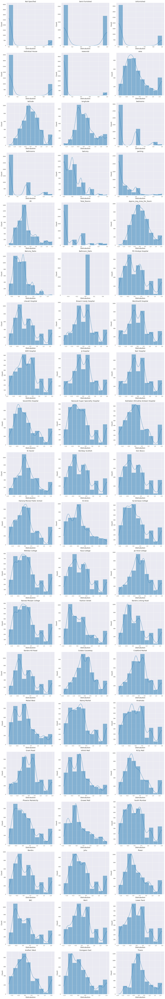

In [ ]:
num_rows = (X_train_impute.shape[1] + 2) // 3
num_cols = 3
plt.figure(figsize=(20, 6 * num_rows))

for i, column in enumerate(columns):
  plt.subplot(num_rows, num_cols, i+1)
  sns.histplot(x=X_train_impute[:, i], bins=10, kde=True)
  plt.title(column, fontsize=14)
  plt.xlabel("Distrubution", fontsize=14)
  plt.ylabel("Count", fontsize=14)

plt.tight_layout()
plt.show()

In [ ]:
power_transform = PowerTransformer(method='yeo-johnson')

power_transform.fit(X_train_impute)
X_train_new = power_transform.transform(X_train_impute)
X_test_new = power_transform.transform(X_test_impute)

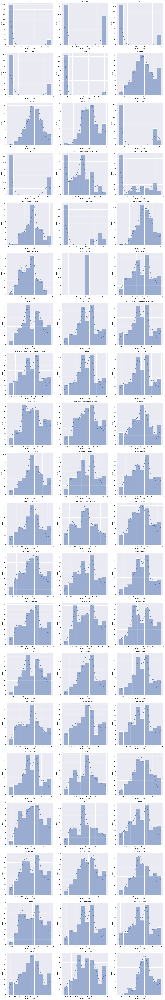

In [ ]:
num_rows = (X_train_new.shape[1] + 2) // 3
num_cols = 3
plt.figure(figsize=(20, 6 * num_rows))

for i, column in enumerate(columns):
  plt.subplot(num_rows, num_cols, i+1)
  sns.histplot(x=X_train_new[:, i], bins=10, kde=True)
  plt.title(column, fontsize=14)
  plt.xlabel("Distrubution", fontsize=14)
  plt.ylabel("Count", fontsize=14)

plt.tight_layout()
plt.show()

In [ ]:
rf_regressor = RandomForestRegressor()
rf_regressor.fit(X_train_new, y_train)

RandomForestRegressor()

## Performace Evaluation

In [ ]:
y_train_pred = rf_regressor.predict(X_train_new)
y_test_pred = rf_regressor.predict(X_test_new)

rf_train_mae = mean_absolute_error(y_train, y_train_pred)
rf_train_mse = mean_squared_error(y_train, y_train_pred)
rf_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rf_train_r2 = r2_score(y_train, y_train_pred)
rf_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

rf_test_mae = mean_absolute_error(y_test, y_test_pred)
rf_test_mse = mean_squared_error(y_test, y_test_pred)
rf_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rf_test_r2 = r2_score(y_test, y_test_pred)
rf_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(rf_train_mae))
print('- MSE: {}'.format(rf_train_mse))
print('- RMSE: {}'.format(rf_train_rmse))
print('- R2 SCORE: {}'.format(rf_train_r2))
print('- Adj R2 SCORE: {}'.format(rf_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(rf_test_mae))
print('- MSE: {}'.format(rf_test_mse))
print('- RMSE: {}'.format(rf_test_rmse))
print('- R2 SCORE: {}'.format(rf_test_r2))
print('- Adj R2 SCORE: {}'.format(rf_test_r2_adj))

Model performance for Training set
- MAE: 1502531.5759304434
- MSE: 5275040129593.803
- RMSE: 2296745.551774032
- R2 SCORE: 0.9753420816104996
- Adj R2 SCORE: 0.975084997435308
----------------------------------
Model performance for Test set
- MAE: 4432349.119809524
- MSE: 47271616103597.95
- RMSE: 6875435.702818982
- R2 SCORE: 0.7965049725248098
- Adj R2 SCORE: 0.7756521251863627


## Feature Importance

In [ ]:
features = ordinal_output_column + ohe_output_column + num_columns

In [ ]:
importances = rf_regressor.feature_importances_
feature_imp_df = pd.DataFrame({'Feature': features, 'Importance': importances})
sor_feature_imp_df = feature_imp_df.sort_values('Importance', ascending=False)
feature_importances = sor_feature_imp_df['Importance'].values
feature_names = sor_feature_imp_df['Feature'].values

In [ ]:
fig = px.bar(x=feature_names, y=feature_importances)
fig.update_layout(
    title="Feature Importance",
    xaxis_title="Feature",
    yaxis_title="Importance",
    xaxis_tickangle=-45,
)
fig.show()

## With Pipelines

In [ ]:
columns = X_train.columns.tolist()

In [ ]:
columns.index('neworold')

6

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

In [ ]:
columns = [column for column in columns if column not in ['neworold']]

In [ ]:
columns = ['neworold'] + columns

In [ ]:
columns.index('type_of_building')  # 'furnished_status', 'type_of_building'

10

In [ ]:
step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

In [ ]:
columns = [column for column in columns if column not in ['furnished_status', 'type_of_building']]

In [ ]:
columns = ['Not-Specified', 'Semi-Furnished', 'Unfurnished', 'Individual House'] + columns

In [ ]:
step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

In [ ]:
robust_scale = columns[5:]
columns = robust_scale + columns[0:5]

## Features:

In [ ]:
columns = ['area',
 'latitude',
 'longitude',
 'bedrooms',
 'bathrooms',
 'balcony',
 'parking',
 'lift',
 'Total_Rooms',
 'Approx_Avg_Area_Per_Room',
 'Balcony_Ratio',
 'Bathroom_Ratio',
 'PD Hinduja Hospital',
 'Lilavati Hospital',
 'Breach Candy Hospital',
 'Wockhardt Hospital',
 'KEM Hospital',
 'JJ Hospital',
 'Nair Hospital',
 'SevenHills Hospital',
 'Nanavati Super Speciality Hospital',
 'Kokilaben Dhirubhai Ambani Hospital',
 'St Xavier',
 'Bombay Scottish',
 'Don Bosco',
 'Hansraj Morarji Public School',
 'St Anne',
 'KJ.Somaiya College',
 'Mithibai College',
 'Ruia College',
 'Jai Hind College',
 'Narsee Monjee College',
 'Fashion Street',
 'Bandra Linking Road',
 'Bandra Hill Road',
 'Colaba Causeway',
 'Crawford Market',
 'Malad West',
 'Natraj Market',
 'Hindmata',
 'Grant Road',
 'Infiniti Mall',
 'RCity Mall',
 'Phoenix Marketcity',
 'Growel Mall',
 'South Mumbai',
 'Bandra',
 'Juhu',
 'Powai',
 'BKC',
 'Worli',
 'Lower Parel',
 'Andheri West',
 'Goregaon East',
 'Thane',
 'Not-Specified',
 'Semi-Furnished',
 'Unfurnished',
 'Individual House',
 'neworold']

# Random Forect With Pipeline

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), list(range(0, 60)))
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = RandomForestRegressor()

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6)
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

rf_train_mae = mean_absolute_error(y_train, y_train_pred)
rf_train_mse = mean_squared_error(y_train, y_train_pred)
rf_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rf_train_r2 = r2_score(y_train, y_train_pred)
rf_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

rf_test_mae = mean_absolute_error(y_test, y_test_pred)
rf_test_mse = mean_squared_error(y_test, y_test_pred)
rf_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rf_test_r2 = r2_score(y_test, y_test_pred)
rf_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(rf_train_mae))
print('- MSE: {}'.format(rf_train_mse))
print('- RMSE: {}'.format(rf_train_rmse))
print('- R2 SCORE: {}'.format(rf_train_r2))
print('- Adj R2 SCORE: {}'.format(rf_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(rf_test_mae))
print('- MSE: {}'.format(rf_test_mse))
print('- RMSE: {}'.format(rf_test_rmse))
print('- R2 SCORE: {}'.format(rf_test_r2))
print('- Adj R2 SCORE: {}'.format(rf_test_r2_adj))

Model performance for Training set
- MAE: 1506825.5176996305
- MSE: 5224991020169.53
- RMSE: 2285823.925889641
- R2 SCORE: 0.9752423106342188
- Adj R2 SCORE: 0.9749187536303398
----------------------------------
Model performance for Test set
- MAE: 4317082.939238095
- MSE: 44342415326264.67
- RMSE: 6659010.086061191
- R2 SCORE: 0.8062004465137818
- Adj R2 SCORE: 0.7967626848830507


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Resale',
                                                                              'New '
                                                                              'Property']]),
                                                  [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrou...
                                                  KNNImputer(n_neighbors=3,
                                                             weights='distance'),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step5',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step6', RandomForestRegressor())])

## Features after pipelines

In [ ]:
first_drop = [column for column in numerical_columns if column not in ['price', 'neworold']]
second_drop = [column for column in first_drop if column not in ["furnished_status", "type_of_building"]]
third_drop = [column for column in second_drop if column not in ["balcony", "parking", "lift", "Balcony_Ratio"]]

In [ ]:
ordinal_output_column = ['neworold']
ohe_output_column = ['Not-Specified', 'Semi-Furnished', 'Unfurnished', 'Individual House']
data_missing_at = ["balcony", "parking", "lift", "Balcony_Ratio"]
features = data_missing_at + third_drop + ohe_output_column + ordinal_output_column

## Random Forest Feature Importance

In [ ]:
importances = pipe.named_steps['step6'].feature_importances_
feature_imp_df = pd.DataFrame({'Feature': features, 'Importance': importances})
sor_feature_imp_df = feature_imp_df.sort_values('Importance', ascending=False)
feature_importances = sor_feature_imp_df['Importance'].values
feature_names = sor_feature_imp_df['Feature'].values

In [ ]:
fig = px.bar(x=feature_names, y=feature_importances)
fig.update_layout(
    title="Feature Importance",
    xaxis_title="Feature",
    yaxis_title="Importance",
    xaxis_tickangle=-45,
)
fig.show()

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

rf_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
rf_score_mean = rf_score.mean()
print("R2 scores for each fold:", rf_score)
print("Mean R2 score across all folds:", rf_score_mean)

R2 scores for each fold: [0.84101402 0.83109306 0.82274533 0.84252159 0.8008599  0.81283977
 0.79982845 0.80535828 0.83870606 0.79691084]
Mean R2 score across all folds: 0.8191877287233709


In [ ]:
y_val_pred = pipe.predict(X_val)
rf_val_mae = mean_absolute_error(y_val, y_val_pred)
rf_val_mse = mean_squared_error(y_val, y_val_pred)
rf_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
rf_val_r2 = r2_score(y_val, y_val_pred)
rf_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(rf_val_mae))
print('- MSE: {}'.format(rf_val_mse))
print('- RMSE: {}'.format(rf_val_rmse))
print('- R2 SCORE: {}'.format(rf_val_r2))
print('- Adj R2 SCORE: {}'.format(rf_val_r2_adj))

Model performance for Validation set
- MAE: 4406206.954285714
- MSE: 44263770018649.38
- RMSE: 6653102.285298895
- R2 SCORE: 0.8052344415756817
- Adj R2 SCORE: 0.7796190166581977


In [ ]:
train_rf_results = calculate_results(y_train, y_train_pred)
test_rf_results = calculate_results(y_test, y_test_pred)
val_rf_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "Random_Forest_Regressor"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_rf_results, test_rf_results, val_rf_results, rf_score_mean)

# Multiple Linear Regression

## Normality Test

In [ ]:
from scipy.stats import shapiro

stat, p = shapiro(X_train['area'])
print("Stat=%.3f, p=%.3f" % (stat, p))
if p > 0.05:
  print("Probably Gaussian")
else:
  print("Probably not Gaussian")

### 1) Normality Assumption

In [ ]:
num_columns = [column for column in numerical_columns if column not in ['price']]

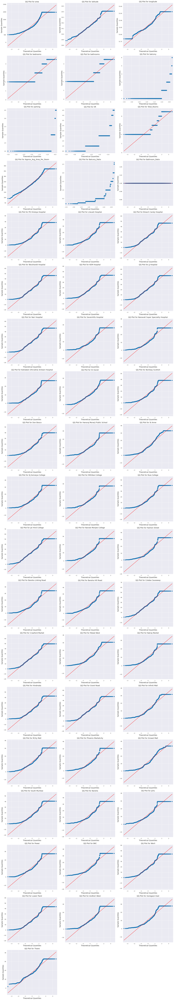

In [ ]:
num_rows = (X_train[num_columns].shape[1] + 2) // 3
num_cols = 3
plt.figure(figsize=(20, 6 * num_rows))

for i, column in enumerate(num_columns):
    plt.subplot(num_rows, num_cols, i + 1)
    sm.qqplot(X_train[column], line='s', ax=plt.gca())
    plt.title(f'QQ Plot for {column}', fontsize=14)
    plt.xlabel("Theoretical Quantiles", fontsize=14)
    plt.ylabel("Sample Quantiles", fontsize=14)

plt.tight_layout()

### 2) Multicollinearity Assumption

In [ ]:
X_train_processed = X_train[num_columns].fillna(0.1)

vif = []
for i in range(X_train_processed.shape[1]):
    vif.append(variance_inflation_factor(X_train_processed.values, i))

multicollinearity = pd.DataFrame({'vif': vif}, index=X_train_processed.columns.astype(str)).T
multicollinearity

,area,latitude,longitude,bedrooms,bathrooms,balcony,parking,lift,Total_Rooms,Approx_Avg_Area_Per_Room,Balcony_Ratio,Bathroom_Ratio,PD Hinduja Hospital,Lilavati Hospital,Breach Candy Hospital,Wockhardt Hospital,KEM Hospital,JJ Hospital,Nair Hospital,SevenHills Hospital,Nanavati Super Speciality Hospital,Kokilaben Dhirubhai Ambani Hospital,St Xavier,Bombay Scottish,Don Bosco,Hansraj Morarji Public School,St Anne,KJ.Somaiya College,Mithibai College,Ruia College,Jai Hind College,Narsee Monjee College,Fashion Street,Bandra Linking Road,Bandra Hill Road,Colaba Causeway,Crawford Market,Malad West,Natraj Market,Hindmata,Grant Road,Infiniti Mall,RCity Mall,Phoenix Marketcity,Growel Mall,South Mumbai,Bandra,Juhu,Powai,BKC,Worli,Lower Parel,Andheri West,Goregaon East,Thane
vif,21.353036,402.290926,83.233603,128.409852,129.281476,16.681737,1.50537,1.502501,428.214466,9.201934,16.359968,3.202660e+08,7.140107e+06,138055.222959,14387.114431,228000.674343,103233.016031,38094.879794,375187.212887,1279.866921,14160.161137,6392.038643,205.779727,6.977173e+06,23639.61557,11087.061594,3454.233904,1634.188072,6.197729e+06,138616.053372,56473.963473,6.020931e+06,47189.238358,35242.841784,175537.49171,28166.816015,39678.322655,8289.167568,2134.416465,160403.902445,49812.699209,9148.483347,1388.845518,10009.285085,450.706528,143504.868165,17659.210093,8059.406023,1257.767315,29563.134343,45960.08318,75082.762992,3846.052306,775.176662,124.972768


In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = SGDRegressor()

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6),
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

lr_train_mae = mean_absolute_error(y_train, y_train_pred)
lr_train_mse = mean_squared_error(y_train, y_train_pred)
lr_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
lr_train_r2 = r2_score(y_train, y_train_pred)
lr_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

lr_test_mae = mean_absolute_error(y_test, y_test_pred)
lr_test_mse = mean_squared_error(y_test, y_test_pred)
lr_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
lr_test_r2 = r2_score(y_test, y_test_pred)
lr_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(lr_train_mae))
print('- MSE: {}'.format(lr_train_mse))
print('- RMSE: {}'.format(lr_train_rmse))
print('- R2 SCORE: {}'.format(lr_train_r2))
print('- Adj R2 SCORE: {}'.format(lr_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(lr_test_mae))
print('- MSE: {}'.format(lr_test_mse))
print('- RMSE: {}'.format(lr_test_rmse))
print('- R2 SCORE: {}'.format(lr_test_r2))
print('- Adj R2 SCORE: {}'.format(lr_test_r2_adj))

Model performance for Training set
- MAE: 5246562.286370946
- MSE: 50622680570822.56
- RMSE: 7114961.740643625
- R2 SCORE: 0.7601334441346228
- Adj R2 SCORE: 0.7569986401147508
----------------------------------
Model performance for Test set
- MAE: 5660451.199759909
- MSE: 60443569345093.8
- RMSE: 7774546.246894014
- R2 SCORE: 0.7358299798510501
- Adj R2 SCORE: 0.7229652769386747


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(), [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('scaler', RobustScale...
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('knn_imputer',
                                                  KNNImputer(n_neighbors=3,
                                                             weights='distance'),
                                                  [5, 6, 7, 10])])),
                ('step5',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step6', SGDRegressor())])

In [ ]:
lr_coef = pipe.named_steps['step6'].coef_
lr_intercept = pipe.named_steps['step6'].intercept_

lr_weights = pd.DataFrame({
    'feature': np.append(feature_names, 1),
    'weights': np.append(lr_coef, lr_intercept)
})

lr_weights = lr_weights.sort_values('weights', ascending=False)

fig = px.bar(x=lr_weights['feature'], y=lr_weights['weights'])
fig.update_layout(
    title="Model Weights",
    xaxis_title="Feature",
    yaxis_title="Weights",
    xaxis_tickangle=-45,
)
fig.show()

## 3) No AutoCorrelation of error Assumption

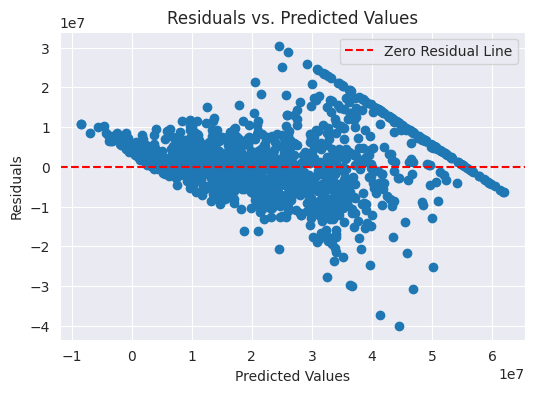

In [ ]:
residuals = y_test - y_test_pred

plt.figure(figsize=(6, 4))
plt.scatter(y_test_pred, residuals)
plt.axhline(y=0, color='r', linestyle='--', label='Zero Residual Line')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.legend();

### 4) Normality of Residual Assumption

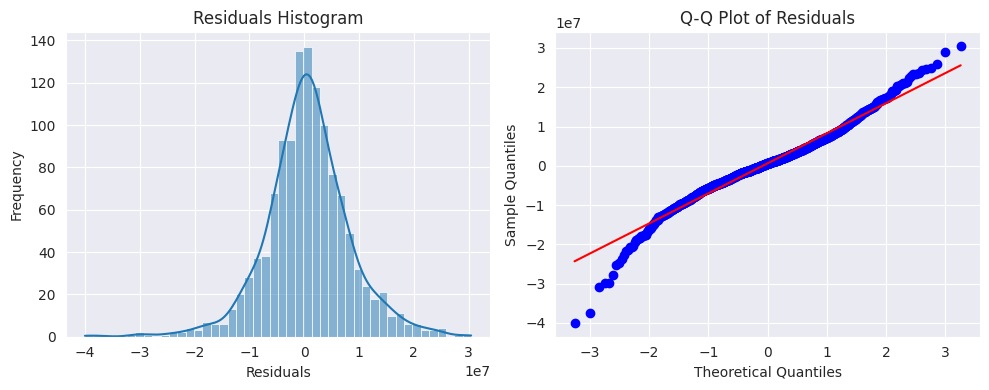

In [ ]:
residuals = np.subtract(y_test, y_test_pred)

fig, axes = plt.subplots(1, 2, figsize=(10, 4))
sns.histplot(residuals, kde=True, ax=axes[0])
axes[0].set_title('Residuals Histogram')
axes[0].set_xlabel('Residuals')
axes[0].set_ylabel('Frequency')

stats.probplot(residuals, plot=axes[1])
axes[1].set_title('Q-Q Plot of Residuals')
axes[1].set_xlabel('Theoretical Quantiles')
axes[1].set_ylabel('Sample Quantiles')

plt.tight_layout()

### 5) Homoscedasticity Assumption

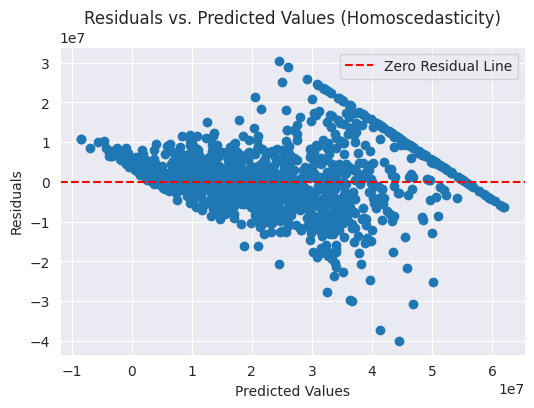

In [ ]:
residuals = y_test - y_test_pred

plt.figure(figsize=(6, 4))
plt.scatter(y_test_pred, residuals)
plt.axhline(y=0, color='r', linestyle='--', label='Zero Residual Line')
plt.title('Residuals vs. Predicted Values (Homoscedasticity)')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.legend()
plt.show()

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

lr_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
lr_score_mean = lr_score.mean()
print("R2 scores for each fold:", lr_score)
print("Mean R2 score across all folds:", lr_score_mean)

R2 scores for each fold: [0.77581643 0.7689845  0.79333718 0.78173899 0.73517652 0.73845375
 0.74527421 0.76167851 0.77549974 0.73079819]
Mean R2 score across all folds: 0.7606758022272959


In [ ]:
y_val_pred = pipe.predict(X_val)
lr_val_mae = mean_absolute_error(y_val, y_val_pred)
lr_val_mse = mean_squared_error(y_val, y_val_pred)
lr_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
lr_val_r2 = r2_score(y_val, y_val_pred)
lr_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(lr_val_mae))
print('- MSE: {}'.format(lr_val_mse))
print('- RMSE: {}'.format(lr_val_rmse))
print('- R2 SCORE: {}'.format(lr_val_r2))
print('- Adj R2 SCORE: {}'.format(lr_val_r2_adj))

Model performance for Validation set
- MAE: 5546189.039626401
- MSE: 52859025800678.09
- RMSE: 7270421.294579709
- R2 SCORE: 0.7674143509805663
- Adj R2 SCORE: 0.7368248551911623


In [ ]:
train_lr_results = calculate_results(y_train, y_train_pred)
test_lr_results = calculate_results(y_test, y_test_pred)
val_lr_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "Multiple_Linear_Regression"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_lr_results, test_lr_results, val_lr_results, lr_score_mean)

# Ridge Regression

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = Ridge(alpha=1.0)

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6),
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

rdg_train_mae = mean_absolute_error(y_train, y_train_pred)
rdg_train_mse = mean_squared_error(y_train, y_train_pred)
rdg_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
rdg_train_r2 = r2_score(y_train, y_train_pred)
rdg_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

rdg_test_mae = mean_absolute_error(y_test, y_test_pred)
rdg_test_mse = mean_squared_error(y_test, y_test_pred)
rdg_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
rdg_test_r2 = r2_score(y_test, y_test_pred)
rdg_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(rdg_train_mae))
print('- MSE: {}'.format(rdg_train_mse))
print('- RMSE: {}'.format(rdg_train_rmse))
print('- R2 SCORE: {}'.format(rdg_train_r2))
print('- Adj R2 SCORE: {}'.format(rdg_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(rdg_test_mae))
print('- MSE: {}'.format(rdg_test_mse))
print('- RMSE: {}'.format(rdg_test_rmse))
print('- R2 SCORE: {}'.format(rdg_test_r2))
print('- Adj R2 SCORE: {}'.format(rdg_test_r2_adj))

Model performance for Training set
- MAE: 4972121.227113194
- MSE: 46556997880467.7
- RMSE: 6823268.855941975
- R2 SCORE: 0.77939795745514
- Adj R2 SCORE: 0.7765149203961941
----------------------------------
Model performance for Test set
- MAE: 5459808.217486591
- MSE: 57716735390773.695
- RMSE: 7597153.110920807
- R2 SCORE: 0.7477476708223239
- Adj R2 SCORE: 0.7354633424492716


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(), [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('scaler', RobustScale...
                ('step4',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('knn_imputer',
                                                  KNNImputer(n_neighbors=3,
                                                             weights='distance'),
                                                  [5, 6, 7, 10])])),
                ('step5',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step6', Ridge())])

In [ ]:
lr_coef = pipe.named_steps['step6'].coef_
lr_intercept = pipe.named_steps['step6'].intercept_

lr_weights = pd.DataFrame({
    'feature': np.append(feature_names, 1),
    'weights': np.append(lr_coef, lr_intercept)
})

lr_weights = lr_weights.sort_values('weights', ascending=False)

fig = px.bar(x=lr_weights['feature'], y=lr_weights['weights'])
fig.update_layout(
    title="Model Weights",
    xaxis_title="Feature",
    yaxis_title="Weights",
    xaxis_tickangle=-45,
)
fig.show()

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

rdg_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
rdg_score_mean = rdg_score.mean()
print("R2 scores for each fold:", rdg_score)
print("Mean R2 score across all folds:", rdg_score_mean)

R2 scores for each fold: [0.78746946 0.78301499 0.79035539 0.78978777 0.74213448 0.75697749
 0.76752309 0.76932455 0.78714729 0.74566614]
Mean R2 score across all folds: 0.771940065380775


In [ ]:
y_val_pred = pipe.predict(X_val)
rdg_val_mae = mean_absolute_error(y_val, y_val_pred)
rdg_val_mse = mean_squared_error(y_val, y_val_pred)
rdg_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
rdg_val_r2 = r2_score(y_val, y_val_pred)
rdg_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(rdg_val_mae))
print('- MSE: {}'.format(rdg_val_mse))
print('- RMSE: {}'.format(rdg_val_rmse))
print('- R2 SCORE: {}'.format(rdg_val_r2))
print('- Adj R2 SCORE: {}'.format(rdg_val_r2_adj))

Model performance for Validation set
- MAE: 5193802.982232385
- MSE: 47910966618242.8
- RMSE: 6921774.817071327
- R2 SCORE: 0.7891863669967698
- Adj R2 SCORE: 0.7614603109555287


In [ ]:
train_rdg_results = calculate_results(y_train, y_train_pred)
test_rdg_results = calculate_results(y_test, y_test_pred)
val_rdg_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "Ridge_Regression"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_rdg_results, test_rdg_results, val_rdg_results, rdg_score_mean)

# Lasso Regression

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = Lasso(alpha=1, max_iter=10000, tol=1e-4)

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6),
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

lso_train_mae = mean_absolute_error(y_train, y_train_pred)
lso_train_mse = mean_squared_error(y_train, y_train_pred)
lso_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
lso_train_r2 = r2_score(y_train, y_train_pred)
lso_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

lso_test_mae = mean_absolute_error(y_test, y_test_pred)
lso_test_mse = mean_squared_error(y_test, y_test_pred)
lso_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
lso_test_r2 = r2_score(y_test, y_test_pred)
lso_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(lso_train_mae))
print('- MSE: {}'.format(lso_train_mse))
print('- RMSE: {}'.format(lso_train_rmse))
print('- R2 SCORE: {}'.format(lso_train_r2))
print('- Adj R2 SCORE: {}'.format(lso_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(lso_test_mae))
print('- MSE: {}'.format(lso_test_mse))
print('- RMSE: {}'.format(lso_test_rmse))
print('- R2 SCORE: {}'.format(lso_test_r2))
print('- Adj R2 SCORE: {}'.format(lso_test_r2_adj))

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.036e+17, tolerance: 9.491e+13



Model performance for Training set
- MAE: 4951209.908592368
- MSE: 46106373174533.59
- RMSE: 6790167.389286776
- R2 SCORE: 0.78153316236688
- Adj R2 SCORE: 0.7786780301941172
----------------------------------
Model performance for Test set
- MAE: 5452827.904736598
- MSE: 57763613832306.04
- RMSE: 7600237.748406693
- R2 SCORE: 0.7475427875075505
- Adj R2 SCORE: 0.7352484816095135


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(), [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('scaler', RobustScale...
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('knn_imputer',
                                                  KNNImputer(n_neighbors=3,
                                                             weights='distance'),
                                                  [5, 6, 7, 10])])),
                ('step5',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step6', Lasso(alpha=1, max_iter=10000))])

In [ ]:
lr_coef = pipe.named_steps['step6'].coef_
lr_intercept = pipe.named_steps['step6'].intercept_

lr_weights = pd.DataFrame({
    'feature': np.append(feature_names, 1),
    'weights': np.append(lr_coef, lr_intercept)
})

lr_weights = lr_weights.sort_values('weights', ascending=False)

fig = px.bar(x=lr_weights['feature'], y=lr_weights['weights'])
fig.update_layout(
    title="Model Weights",
    xaxis_title="Feature",
    yaxis_title="Weights",
    xaxis_tickangle=-45,
)
fig.show()

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

lso_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
lso_score_mean = lso_score.mean()
print("R2 scores for each fold:", lso_score)
print("Mean R2 score across all folds:", lso_score_mean)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.382e+16, tolerance: 8.559e+13

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.245e+16, tolerance: 8.406e+13

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.268e+16, tolerance: 8.440e+13

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_des

R2 scores for each fold: [0.78553589 0.78703574 0.7883878  0.78960207 0.74474757 0.76277895
 0.76480051 0.76968048 0.79168653 0.74962341]
Mean R2 score across all folds: 0.7733878948965262


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.176e+16, tolerance: 8.530e+13



In [ ]:
y_val_pred = pipe.predict(X_val)
lso_val_mae = mean_absolute_error(y_val, y_val_pred)
lso_val_mse = mean_squared_error(y_val, y_val_pred)
lso_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
lso_val_r2 = r2_score(y_val, y_val_pred)
lso_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(lso_val_mae))
print('- MSE: {}'.format(lso_val_mse))
print('- RMSE: {}'.format(lso_val_rmse))
print('- R2 SCORE: {}'.format(lso_val_r2))
print('- Adj R2 SCORE: {}'.format(lso_val_r2_adj))

Model performance for Validation set
- MAE: 5159533.378730919
- MSE: 47234307073127.484
- RMSE: 6872721.955173764
- R2 SCORE: 0.79216374497682
- Adj R2 SCORE: 0.7648292715270594


In [ ]:
train_lso_results = calculate_results(y_train, y_train_pred)
test_lso_results = calculate_results(y_test, y_test_pred)
val_lso_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "Lasso_Regression"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_lso_results, test_lso_results, val_lso_results, lso_score_mean)

# Elastic Net Regression

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = ElasticNet(alpha=0.1, l1_ratio=0.90)

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6),
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

elnet_train_mae = mean_absolute_error(y_train, y_train_pred)
elnet_train_mse = mean_squared_error(y_train, y_train_pred)
elnet_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
elnet_train_r2 = r2_score(y_train, y_train_pred)
elnet_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

elnet_test_mae = mean_absolute_error(y_test, y_test_pred)
elnet_test_mse = mean_squared_error(y_test, y_test_pred)
elnet_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
elnet_test_r2 = r2_score(y_test, y_test_pred)
elnet_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(elnet_train_mae))
print('- MSE: {}'.format(elnet_train_mse))
print('- RMSE: {}'.format(elnet_train_rmse))
print('- R2 SCORE: {}'.format(elnet_train_r2))
print('- Adj R2 SCORE: {}'.format(elnet_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(elnet_test_mae))
print('- MSE: {}'.format(elnet_test_mse))
print('- RMSE: {}'.format(elnet_test_rmse))
print('- R2 SCORE: {}'.format(elnet_test_r2))
print('- Adj R2 SCORE: {}'.format(elnet_test_r2_adj))

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.140e+17, tolerance: 9.491e+13



Model performance for Training set
- MAE: 5129654.39653831
- MSE: 49228108659450.375
- RMSE: 7016274.557017447
- R2 SCORE: 0.7667413747600951
- Adj R2 SCORE: 0.763692929455022
----------------------------------
Model performance for Test set
- MAE: 5542567.3519421015
- MSE: 59379930067047.5
- RMSE: 7705837.402063938
- R2 SCORE: 0.7404786399576113
- Adj R2 SCORE: 0.7278403201570585


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(), [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('scaler', RobustScale...
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('knn_imputer',
                                                  KNNImputer(n_neighbors=3,
                                                             weights='distance'),
                                                  [5, 6, 7, 10])])),
                ('step5',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step6', ElasticNet(alpha=0.1, l1_ratio=0.9))])

In [ ]:
lr_coef = pipe.named_steps['step6'].coef_
lr_intercept = pipe.named_steps['step6'].intercept_

lr_weights = pd.DataFrame({
    'feature': np.append(feature_names, 1),
    'weights': np.append(lr_coef, lr_intercept)
})

lr_weights = lr_weights.sort_values('weights', ascending=False)

fig = px.bar(x=lr_weights['feature'], y=lr_weights['weights'])
fig.update_layout(
    title="Model Weights",
    xaxis_title="Feature",
    yaxis_title="Weights",
    xaxis_tickangle=-45,
)
fig.show()

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

elnet_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
elnet_score_mean = elnet_score.mean()
print("R2 scores for each fold:", elnet_score)
print("Mean R2 score across all folds:", elnet_score_mean)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.034e+17, tolerance: 8.559e+13

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.014e+17, tolerance: 8.406e+13

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.029e+17, tolerance: 8.440e+13

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_des

R2 scores for each fold: [0.77615269 0.7686909  0.79337081 0.78169119 0.73548309 0.73707735
 0.75683067 0.75957202 0.77359188 0.73127161]
Mean R2 score across all folds: 0.7613732200050082


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.007e+17, tolerance: 8.530e+13



In [ ]:
y_val_pred = pipe.predict(X_val)
elnet_val_mae = mean_absolute_error(y_val, y_val_pred)
elnet_val_mse = mean_squared_error(y_val, y_val_pred)
elnet_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
elnet_val_r2 = r2_score(y_val, y_val_pred)
elnet_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(elnet_val_mae))
print('- MSE: {}'.format(elnet_val_mse))
print('- RMSE: {}'.format(elnet_val_rmse))
print('- R2 SCORE: {}'.format(elnet_val_r2))
print('- Adj R2 SCORE: {}'.format(elnet_val_r2_adj))

Model performance for Validation set
- MAE: 5364841.673296927
- MSE: 50924683439278.65
- RMSE: 7136153.266240759
- R2 SCORE: 0.7759256745764337
- Adj R2 SCORE: 0.7464555818903411


In [ ]:
train_elnet_results = calculate_results(y_train, y_train_pred)
test_elnet_results = calculate_results(y_test, y_test_pred)
val_elnet_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "Elastic_Net_Regression"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_elnet_results, test_elnet_results, val_elnet_results, elnet_score_mean)

# Ada Boosting

In [ ]:
from sklearn.ensemble import AdaBoostRegressor

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = AdaBoostRegressor()

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6)
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

adb_train_mae = mean_absolute_error(y_train, y_train_pred)
adb_train_mse = mean_squared_error(y_train, y_train_pred)
adb_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
adb_train_r2 = r2_score(y_train, y_train_pred)
adb_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

adb_test_mae = mean_absolute_error(y_test, y_test_pred)
adb_test_mse = mean_squared_error(y_test, y_test_pred)
adb_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
adb_test_r2 = r2_score(y_test, y_test_pred)
adb_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(adb_train_mae))
print('- MSE: {}'.format(adb_train_mse))
print('- RMSE: {}'.format(adb_train_rmse))
print('- R2 SCORE: {}'.format(adb_train_r2))
print('- Adj R2 SCORE: {}'.format(adb_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(adb_test_mae))
print('- MSE: {}'.format(adb_test_mse))
print('- RMSE: {}'.format(adb_test_rmse))
print('- R2 SCORE: {}'.format(adb_test_r2))
print('- Adj R2 SCORE: {}'.format(adb_test_r2_adj))

Model performance for Training set
- MAE: 6412668.594266483
- MSE: 65479286330986.37
- RMSE: 8091927.232185567
- R2 SCORE: 0.689738063736806
- Adj R2 SCORE: 0.6856832660118701
----------------------------------
Model performance for Test set
- MAE: 6810062.545811073
- MSE: 77253928969092.73
- RMSE: 8789421.424024038
- R2 SCORE: 0.6623599136604049
- Adj R2 SCORE: 0.6459173233936573


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Resale',
                                                                              'New '
                                                                              'Property']]),
                                                  [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrou...
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('knn_imputer',
                                                  KNNImputer(n_neighbors=3,
                                                             weights='distance'),
                                                  [5, 6, 7, 10])])),
                ('step5',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step6', AdaBoostRegressor())])

In [ ]:
importances = pipe.named_steps['step6'].feature_importances_
feature_imp_df = pd.DataFrame({'Feature': features, 'Importance': importances})
sor_feature_imp_df = feature_imp_df.sort_values('Importance', ascending=False)
feature_importances = sor_feature_imp_df['Importance'].values
feature_names = sor_feature_imp_df['Feature'].values

In [ ]:
fig = px.bar(x=feature_names, y=feature_importances)
fig.update_layout(
    title="Feature Importance",
    xaxis_title="Feature",
    yaxis_title="Importance",
    xaxis_tickangle=-45,
)
fig.show()

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

adb_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
adb_score_mean = adb_score.mean()
print("R2 scores for each fold:", adb_score)
print("Mean R2 score across all folds:", adb_score_mean)

R2 scores for each fold: [0.69528523 0.68615958 0.73364272 0.6507969  0.65539811 0.67204814
 0.65462876 0.66501719 0.65281549 0.69653931]
Mean R2 score across all folds: 0.6762331422680286


In [ ]:
y_val_pred = pipe.predict(X_val)
adb_val_mae = mean_absolute_error(y_val, y_val_pred)
adb_val_mse = mean_squared_error(y_val, y_val_pred)
adb_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
adb_val_r2 = r2_score(y_val, y_val_pred)
adb_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(adb_val_mae))
print('- MSE: {}'.format(adb_val_mse))
print('- RMSE: {}'.format(adb_val_rmse))
print('- R2 SCORE: {}'.format(adb_val_r2))
print('- Adj R2 SCORE: {}'.format(adb_val_r2_adj))

Model performance for Validation set
- MAE: 6718900.392089074
- MSE: 71694248659283.64
- RMSE: 8467245.635936378
- R2 SCORE: 0.6845372554110478
- Adj R2 SCORE: 0.6430478241499158


In [ ]:
train_adb_results = calculate_results(y_train, y_train_pred)
test_adb_results = calculate_results(y_test, y_test_pred)
val_adb_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "Ada-Boost_Regressor"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_adb_results, test_adb_results, val_adb_results, elnet_score_mean)

# Gradient Boosting Regression

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = GradientBoostingRegressor()

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6)
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

gbr_train_mae = mean_absolute_error(y_train, y_train_pred)
gbr_train_mse = mean_squared_error(y_train, y_train_pred)
gbr_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
gbr_train_r2 = r2_score(y_train, y_train_pred)
gbr_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

gbr_test_mae = mean_absolute_error(y_test, y_test_pred)
gbr_test_mse = mean_squared_error(y_test, y_test_pred)
gbr_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
gbr_test_r2 = r2_score(y_test, y_test_pred)
gbr_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(gbr_train_mae))
print('- MSE: {}'.format(gbr_train_mse))
print('- RMSE: {}'.format(gbr_train_rmse))
print('- R2 SCORE: {}'.format(gbr_train_r2))
print('- Adj R2 SCORE: {}'.format(gbr_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(gbr_test_mae))
print('- MSE: {}'.format(gbr_test_mse))
print('- RMSE: {}'.format(gbr_test_rmse))
print('- R2 SCORE: {}'.format(gbr_test_r2))
print('- Adj R2 SCORE: {}'.format(gbr_test_r2_adj))

Model performance for Training set
- MAE: 3780835.348957846
- MSE: 28758271365351.703
- RMSE: 5362673.90070958
- R2 SCORE: 0.8637340530516137
- Adj R2 SCORE: 0.8619532002073129
----------------------------------
Model performance for Test set
- MAE: 4480524.035240843
- MSE: 45399030363903.14
- RMSE: 6737880.257462516
- R2 SCORE: 0.801582486012657
- Adj R2 SCORE: 0.7919198362970685


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Resale',
                                                                              'New '
                                                                              'Property']]),
                                                  [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrou...
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('knn_imputer',
                                                  KNNImputer(n_neighbors=3,
                                                             weights='distance'),
                                                  [5, 6, 7, 10])])),
                ('step5',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step6', GradientBoostingRegressor())])

In [ ]:
importances = pipe.named_steps['step6'].feature_importances_
feature_imp_df = pd.DataFrame({'Feature': features, 'Importance': importances})
sor_feature_imp_df = feature_imp_df.sort_values('Importance', ascending=False)
feature_importances = sor_feature_imp_df['Importance'].values
feature_names = sor_feature_imp_df['Feature'].values

In [ ]:
fig = px.bar(x=feature_names, y=feature_importances)
fig.update_layout(
    title="Feature Importance",
    xaxis_title="Feature",
    yaxis_title="Importance",
    xaxis_tickangle=-45,
)
fig.show()

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

gbr_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
gbr_score_mean = gbr_score.mean()
print("R2 scores for each fold:", gbr_score)
print("Mean R2 score across all folds:", gbr_score_mean)

R2 scores for each fold: [0.84133238 0.82968752 0.82871318 0.84196747 0.80103122 0.79303827
 0.8059382  0.82525602 0.82750068 0.80010295]
Mean R2 score across all folds: 0.8194567877263605


In [ ]:
y_val_pred = pipe.predict(X_val)
gbr_val_mae = mean_absolute_error(y_val, y_val_pred)
gbr_val_mse = mean_squared_error(y_val, y_val_pred)
gbr_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
gbr_val_r2 = r2_score(y_val, y_val_pred)
gbr_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(gbr_val_mae))
print('- MSE: {}'.format(gbr_val_mse))
print('- RMSE: {}'.format(gbr_val_rmse))
print('- R2 SCORE: {}'.format(gbr_val_r2))
print('- Adj R2 SCORE: {}'.format(gbr_val_r2_adj))

Model performance for Validation set
- MAE: 4475176.583219858
- MSE: 42450980933537.62
- RMSE: 6515441.729732346
- R2 SCORE: 0.8132109171067661
- Adj R2 SCORE: 0.7886445524632115


In [ ]:
train_gbr_results = calculate_results(y_train, y_train_pred)
test_gbr_results = calculate_results(y_test, y_test_pred)
val_gbr_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "Gradient-Boost_Regressor"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_gbr_results, test_gbr_results, val_gbr_results, gbr_score_mean)

In [ ]:
tree_index = 0  # Get the estimator of the specific tree
estimator = pipe.named_steps['step6'].estimators_[tree_index][0]

dot_data = export_graphviz(
    estimator,
    out_file=None,
    feature_names=features,
    class_names= ['price'],
    filled=True,
    rounded=True
)

graph = graphviz.Source(dot_data)
graph.render('gradient_boosting_tree', format='png')


image_path = 'gradient_boosting_tree.png'
image = mpimg.imread(image_path)
fig = plt.figure(figsize=(18, 10), dpi=100)
plt.imshow(image)
plt.axis('off')
plt.show()

# XGBoost Regression

In [ ]:
from xgboost import XGBRegressor

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = XGBRegressor()

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6)
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

xgb_train_mae = mean_absolute_error(y_train, y_train_pred)
xgb_train_mse = mean_squared_error(y_train, y_train_pred)
xgb_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
xgb_train_r2 = r2_score(y_train, y_train_pred)
xgb_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

xgb_test_mae = mean_absolute_error(y_test, y_test_pred)
xgb_test_mse = mean_squared_error(y_test, y_test_pred)
xgb_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
xgb_test_r2 = r2_score(y_test, y_test_pred)
xgb_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(xgb_train_mae))
print('- MSE: {}'.format(xgb_train_mse))
print('- RMSE: {}'.format(xgb_train_rmse))
print('- R2 SCORE: {}'.format(xgb_train_r2))
print('- Adj R2 SCORE: {}'.format(xgb_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(xgb_test_mae))
print('- MSE: {}'.format(xgb_test_mse))
print('- RMSE: {}'.format(xgb_test_rmse))
print('- R2 SCORE: {}'.format(xgb_test_r2))
print('- Adj R2 SCORE: {}'.format(xgb_test_r2_adj))

Model performance for Training set
- MAE: 1900054.7431065154
- MSE: 7542347797400.224
- RMSE: 2746333.5189667377
- R2 SCORE: 0.964261928272049
- Adj R2 SCORE: 0.9637948692003453
----------------------------------
Model performance for Test set
- MAE: 4352741.9025
- MSE: 45312339738410.18
- RMSE: 6731444.104975557
- R2 SCORE: 0.8019613693997789
- Adj R2 SCORE: 0.7923171707643357


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Resale',
                                                                              'New '
                                                                              'Property']]),
                                                  [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrou...
                              feature_types=None, gamma=None, gpu_id=None,
                              grow_policy=None, importance_type=None,
                              interaction_constraints=None, learning_rate=None,
                              max_bin=None, max_cat_threshold=None,
                              max_cat_to_onehot=None, max_delta_step=None,
                              max_depth=None, max_leaves=None,
                              min_child_weight=None, missing=nan,
                              monotone_constraints=None, n_estimators=100,
                              n_jobs=None, num_parallel_tree=None,
                              predictor=None, random_state=None, ...))])

In [ ]:
importances = pipe.named_steps['step6'].feature_importances_
feature_imp_df = pd.DataFrame({'Feature': features, 'Importance': importances})
sor_feature_imp_df = feature_imp_df.sort_values('Importance', ascending=False)
feature_importances = sor_feature_imp_df['Importance'].values
feature_names = sor_feature_imp_df['Feature'].values

In [ ]:
fig = px.bar(x=feature_names, y=feature_importances)
fig.update_layout(
    title="Feature Importance",
    xaxis_title="Feature",
    yaxis_title="Importance",
    xaxis_tickangle=-45,
)
fig.show()

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

xgb_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
xgb_score_mean = xgb_score.mean()
print("R2 scores for each fold:", xgb_score)
print("Mean R2 score across all folds:", xgb_score_mean)

R2 scores for each fold: [0.83780763 0.82396218 0.8266248  0.81940751 0.80966353 0.79644601
 0.79012605 0.81639416 0.83312641 0.79222236]
Mean R2 score across all folds: 0.814578064767316


In [ ]:
y_val_pred = pipe.predict(X_val)
xgb_val_mae = mean_absolute_error(y_val, y_val_pred)
xgb_val_mse = mean_squared_error(y_val, y_val_pred)
xgb_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
xgb_val_r2 = r2_score(y_val, y_val_pred)
xgb_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(xgb_val_mae))
print('- MSE: {}'.format(xgb_val_mse))
print('- RMSE: {}'.format(xgb_val_rmse))
print('- R2 SCORE: {}'.format(xgb_val_r2))
print('- Adj R2 SCORE: {}'.format(xgb_val_r2_adj))

Model performance for Validation set
- MAE: 4427435.318
- MSE: 44324192607342.11
- RMSE: 6657641.670091753
- R2 SCORE: 0.804968575400631
- Adj R2 SCORE: 0.7793181839567231


In [ ]:
train_xgb_results = calculate_results(y_train, y_train_pred)
test_xgb_results = calculate_results(y_test, y_test_pred)
val_xgb_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "Ex-Gradient-Boost_Regressor"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_xgb_results, test_xgb_results, val_xgb_results, xgb_score_mean)

In [ ]:
tree_index = 0  # Get the estimator of the specific tree
estimator = pipe.named_steps['step6'].estimators_[tree_index][0]

dot_data = export_graphviz(
    estimator,
    out_file=None,
    feature_names=features,
    class_names= ['price'],
    filled=True,
    rounded=True
)

graph = graphviz.Source(dot_data)
graph.render('gradient_boosting_tree', format='png')


image_path = 'gradient_boosting_tree.png'
image = mpimg.imread(image_path)
fig = plt.figure(figsize=(18, 10), dpi=100)
plt.imshow(image)
plt.axis('off')
plt.show()

# KNN Regression

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

In [ ]:
step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')

step6 = KNeighborsRegressor()

pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
    ('step6', step6)
])

pipe.fit(X_train, y_train)

y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)

knn_train_mae = mean_absolute_error(y_train, y_train_pred)
knn_train_mse = mean_squared_error(y_train, y_train_pred)
knn_train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
knn_train_r2 = r2_score(y_train, y_train_pred)
knn_train_r2_adj = adjusted_r2_score(y_train, y_train_pred, X_train.shape[0], X_train.shape[1])

knn_test_mae = mean_absolute_error(y_test, y_test_pred)
knn_test_mse = mean_squared_error(y_test, y_test_pred)
knn_test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
knn_test_r2 = r2_score(y_test, y_test_pred)
knn_test_r2_adj = adjusted_r2_score(y_test, y_test_pred, X_test.shape[0], X_test.shape[1])

print('Model performance for Training set')
print('- MAE: {}'.format(knn_train_mae))
print('- MSE: {}'.format(knn_train_mse))
print('- RMSE: {}'.format(knn_train_rmse))
print('- R2 SCORE: {}'.format(knn_train_r2))
print('- Adj R2 SCORE: {}'.format(knn_train_r2_adj))
print('----------------------------------')
print('Model performance for Test set')
print('- MAE: {}'.format(knn_test_mae))
print('- MSE: {}'.format(knn_test_mse))
print('- RMSE: {}'.format(knn_test_rmse))
print('- R2 SCORE: {}'.format(knn_test_r2))
print('- Adj R2 SCORE: {}'.format(knn_test_r2_adj))

Model performance for Training set
- MAE: 4169746.49766511
- MSE: 37668149065599.29
- RMSE: 6137438.314606452
- R2 SCORE: 0.8215161844393395
- Adj R2 SCORE: 0.8191835883819897
----------------------------------
Model performance for Test set
- MAE: 5476366.4
- MSE: 65709533398400.0
- RMSE: 8106141.708507198
- R2 SCORE: 0.7128149619568684
- Adj R2 SCORE: 0.6988294605240375


In [ ]:
set_config(display="diagram")
pipe

Pipeline(steps=[('step1',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Resale',
                                                                              'New '
                                                                              'Property']]),
                                                  [6])])),
                ('step2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe_encoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  [8, 10])])),
                ('step3',
                 ColumnTransformer(remainder='passthrou...
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('knn_imputer',
                                                  KNNImputer(n_neighbors=3,
                                                             weights='distance'),
                                                  [5, 6, 7, 10])])),
                ('step5',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...])])),
                ('step6', KNeighborsRegressor())])

In [ ]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

knn_score = cross_val_score(pipe, X_train, y_train, cv=kfold, scoring='r2')
knn_score_mean = knn_score.mean()
print("R2 scores for each fold:", knn_score)
print("Mean R2 score across all folds:", knn_score_mean)

R2 scores for each fold: [0.77368176 0.755848   0.76106975 0.74979546 0.70881784 0.68163096
 0.72917731 0.74023296 0.72043628 0.70187249]
Mean R2 score across all folds: 0.7322562800000395


In [ ]:
y_val_pred = pipe.predict(X_val)
knn_val_mae = mean_absolute_error(y_val, y_val_pred)
knn_val_mse = mean_squared_error(y_val, y_val_pred)
knn_val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
knn_val_r2 = r2_score(y_val, y_val_pred)
knn_val_r2_adj = adjusted_r2_score(y_val, y_val_pred, X_val.shape[0], X_val.shape[1])

print('Model performance for Validation set')
print('- MAE: {}'.format(knn_val_mae))
print('- MSE: {}'.format(knn_val_mse))
print('- RMSE: {}'.format(knn_val_rmse))
print('- R2 SCORE: {}'.format(knn_val_r2))
print('- Adj R2 SCORE: {}'.format(knn_val_r2_adj))

Model performance for Validation set
- MAE: 5418372.0
- MSE: 62368673992000.0
- RMSE: 7897383.996742212
- R2 SCORE: 0.7255708311081908
- Adj R2 SCORE: 0.6894781059478168


In [ ]:
train_knn_results = calculate_results(y_train, y_train_pred)
test_knn_results = calculate_results(y_test, y_test_pred)
val_knn_results = calculate_results(y_val, y_val_pred)

In [ ]:
experiment_name = "KNN_Regressor"
run_name = "First_Run"
create_experiment(experiment_name, run_name, train_knn_results, test_knn_results, val_knn_results, knn_score_mean)

# All Models Performace

In [ ]:
all_model_train_results = pd.DataFrame({"Random Forest Regressor": train_rf_results,
                                  "Multiple Linear Regression": train_lr_results,
                                  "Ridge Regression": train_rdg_results,
                                  "Lasso Regression": train_lso_results,
                                  "Elastic Net Regression": train_elnet_results,
                                  "Ada-Boost Regressor": train_adb_results,
                                  "Gradient-Boost Regressor": train_gbr_results,
                                  "Ex Gradient-Boost Regressor": train_xgb_results,
                                  "KNN Regressor": train_knn_results})

all_model_train_results = all_model_train_results.transpose()
all_model_train_results

,MAE,MSE,RMSE,R2,Adjusted R2
Random Forest Regressor,1.503689e+06,5.141897e+12,2.267575e+06,0.975636,0.975631
Multiple Linear Regression,5.246562e+06,5.062268e+13,7.114962e+06,0.760133,0.760080
Ridge Regression,4.972121e+06,4.655700e+13,6.823269e+06,0.779398,0.779349
Lasso Regression,4.951210e+06,4.610637e+13,6.790167e+06,0.781533,0.781485
Elastic Net Regression,5.129654e+06,4.922811e+13,7.016275e+06,0.766741,0.766689
Ada-Boost Regressor,6.412669e+06,6.547929e+13,8.091927e+06,0.689738,0.689669
Gradient-Boost Regressor,3.780835e+06,2.875827e+13,5.362674e+06,0.863734,0.863704
Ex Gradient-Boost Regressor,1.900055e+06,7.542348e+12,2.746334e+06,0.964262,0.964254
KNN Regressor,4.169746e+06,3.766815e+13,6.137438e+06,0.821516,0.821476


In [ ]:
all_model_test_results = pd.DataFrame({"Random Forest Regressor": test_rf_results,
                                  "Multiple Linear Regression": test_lr_results,
                                  "Ridge Regression": test_rdg_results,
                                  "Lasso Regression": test_lso_results,
                                  "Elastic Net Regression": test_elnet_results,
                                  "Ada-Boost Regressor": test_adb_results,
                                  "Gradient-Boost Regressor": test_gbr_results,
                                  "Ex Gradient-Boost Regressor": test_xgb_results,
                                  "KNN Regressor": test_knn_results})

all_model_test_results = all_model_test_results.transpose()
all_model_test_results

,MAE,MSE,RMSE,R2,Adjusted R2
Random Forest Regressor,4.340204e+06,4.496300e+13,6.705445e+06,0.803488,0.803331
Multiple Linear Regression,5.660451e+06,6.044357e+13,7.774546e+06,0.735830,0.735618
Ridge Regression,5.459808e+06,5.771674e+13,7.597153e+06,0.747748,0.747546
Lasso Regression,5.452828e+06,5.776361e+13,7.600238e+06,0.747543,0.747340
Elastic Net Regression,5.542567e+06,5.937993e+13,7.705837e+06,0.740479,0.740271
Ada-Boost Regressor,6.810063e+06,7.725393e+13,8.789421e+06,0.662360,0.662089
Gradient-Boost Regressor,4.480524e+06,4.539903e+13,6.737880e+06,0.801582,0.801423
Ex Gradient-Boost Regressor,4.352742e+06,4.531234e+13,6.731444e+06,0.801961,0.801803
KNN Regressor,5.476366e+06,6.570953e+13,8.106142e+06,0.712815,0.712585


In [ ]:
all_model_val_results = pd.DataFrame({"Random Forest Regressor": val_rf_results,
                                  "Multiple Linear Regression": val_lr_results,
                                  "Ridge Regression": val_rdg_results,
                                  "Lasso Regression": val_lso_results,
                                  "Elastic Net Regression": val_elnet_results,
                                  "Ada-Boost Regressor": val_adb_results,
                                  "Gradient-Boost Regressor": val_gbr_results,
                                  "Ex Gradient-Boost Regressor": val_xgb_results,
                                  "KNN Regressor": val_knn_results})

all_model_val_results = all_model_val_results.transpose()
all_model_val_results

,MAE,MSE,RMSE,R2,Adjusted R2
Random Forest Regressor,4.406207e+06,4.426377e+13,6.653102e+06,0.805234,0.804843
Multiple Linear Regression,5.546189e+06,5.285903e+13,7.270421e+06,0.767414,0.766947
Ridge Regression,5.193803e+06,4.791097e+13,6.921775e+06,0.789186,0.788763
Lasso Regression,5.159533e+06,4.723431e+13,6.872722e+06,0.792164,0.791746
Elastic Net Regression,5.364842e+06,5.092468e+13,7.136153e+06,0.775926,0.775476
Ada-Boost Regressor,6.718900e+06,7.169425e+13,8.467246e+06,0.684537,0.683904
Gradient-Boost Regressor,4.475177e+06,4.245098e+13,6.515442e+06,0.813211,0.812836
Ex Gradient-Boost Regressor,4.427435e+06,4.432419e+13,6.657642e+06,0.804969,0.804577
KNN Regressor,5.418372e+06,6.236867e+13,7.897384e+06,0.725571,0.725020


In [ ]:
data = {
    "Model": ["Random Forest Regressor", "Multiple Linear Regression",
              "Ridge Regression", "Lasso Regression",
              "Elastic Net Regression", "Ada-Boost Regressor",
              "Gradient-Boost Regressor", "Ex Gradient-Boost Regressor", "KNN Regressor"],
    "R2-Score": [rf_score_mean, lr_score_mean, rdg_score_mean,
              lso_score_mean, elnet_score_mean, adb_score_mean,
              gbr_score_mean, xgb_score_mean, knn_score_mean]}

all_model_cv_results = pd.DataFrame(data)
all_model_cv_results = all_model_cv_results.set_index("Model")
all_model_cv_results

,R2-Score
Model,
Random Forest Regressor,0.819188
Multiple Linear Regression,0.760676
Ridge Regression,0.771940
Lasso Regression,0.773388
Elastic Net Regression,0.761373
Ada-Boost Regressor,0.676233
Gradient-Boost Regressor,0.819457
Ex Gradient-Boost Regressor,0.814578
KNN Regressor,0.732256


# Multicollinearity

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')


pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
])

X_train_trf = pipe.fit_transform(X_train, y_train)
X_test_trf = pipe.transform(X_test)

In [ ]:
vif = []
for i in range(X_train_trf.shape[1]):
    vif.append(variance_inflation_factor(X_train_trf, i))

multicollinearity = pd.DataFrame({'vif': vif}, index=features).T
multicollinearity

/usr/local/lib/python3.10/dist-packages/statsmodels/regression/linear_model.py:1783: RuntimeWarning:

invalid value encountered in double_scalars



,balcony,parking,lift,Balcony_Ratio,area,latitude,longitude,bedrooms,bathrooms,Total_Rooms,Approx_Avg_Area_Per_Room,Bathroom_Ratio,PD Hinduja Hospital,Lilavati Hospital,Breach Candy Hospital,Wockhardt Hospital,KEM Hospital,JJ Hospital,Nair Hospital,SevenHills Hospital,Nanavati Super Speciality Hospital,Kokilaben Dhirubhai Ambani Hospital,St Xavier,Bombay Scottish,Don Bosco,Hansraj Morarji Public School,St Anne,KJ.Somaiya College,Mithibai College,Ruia College,Jai Hind College,Narsee Monjee College,Fashion Street,Bandra Linking Road,Bandra Hill Road,Colaba Causeway,Crawford Market,Malad West,Natraj Market,Hindmata,Grant Road,Infiniti Mall,RCity Mall,Phoenix Marketcity,Growel Mall,South Mumbai,Bandra,Juhu,Powai,BKC,Worli,Lower Parel,Andheri West,Goregaon East,Thane,Not-Specified,Semi-Furnished,Unfurnished,Individual House,neworold
vif,9.10544,1.235359,1.245715,9.559817,28.273716,232.545885,20.758309,21.920285,11.036862,43.661952,15.32925,NaN,3.513357e+06,38649.400368,8439.163451,119472.344928,44172.328897,21882.459116,202893.40151,296.748145,5450.185901,3988.135158,67.400492,3.384457e+06,7350.240833,4623.502101,1577.966853,389.65618,1.769827e+06,70355.825069,39790.665779,1.693832e+06,8474.901774,12074.665095,44503.795285,18962.258248,24271.303007,4207.387044,687.346858,66959.080548,28923.782024,4767.121984,360.552037,1999.655009,158.957045,58010.771102,12941.118276,2533.909244,302.396952,5771.053869,20519.930797,34388.991729,1977.773226,315.519539,31.49425,2.259644,1.832334,1.942927,1.012759,1.05419


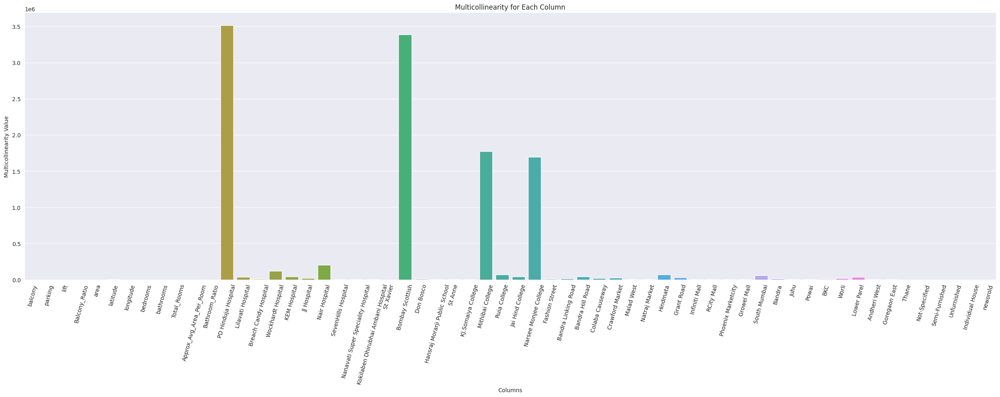

In [ ]:
plt.figure(figsize=(25, 10))
sns.barplot(data=multicollinearity)
plt.title("Multicollinearity for Each Column")
plt.xlabel('Columns')
plt.ylabel('Multicollinearity Value')
plt.xticks(rotation=75)
plt.tight_layout();

# Data Drift Detection using hypothesis testing

# Explanability of model

In [ ]:
! pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 4.7 MB/s eta 0:00:00


In [ ]:
import shap

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')


pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
])

X_train_trf = pipe.fit_transform(X_train, y_train)
X_test_trf = pipe.transform(X_test)

In [ ]:
model = GradientBoostingRegressor()
model.fit(X_train_trf, y_train)

explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train_trf)

## Visualization 1: Shap Summary bar plot

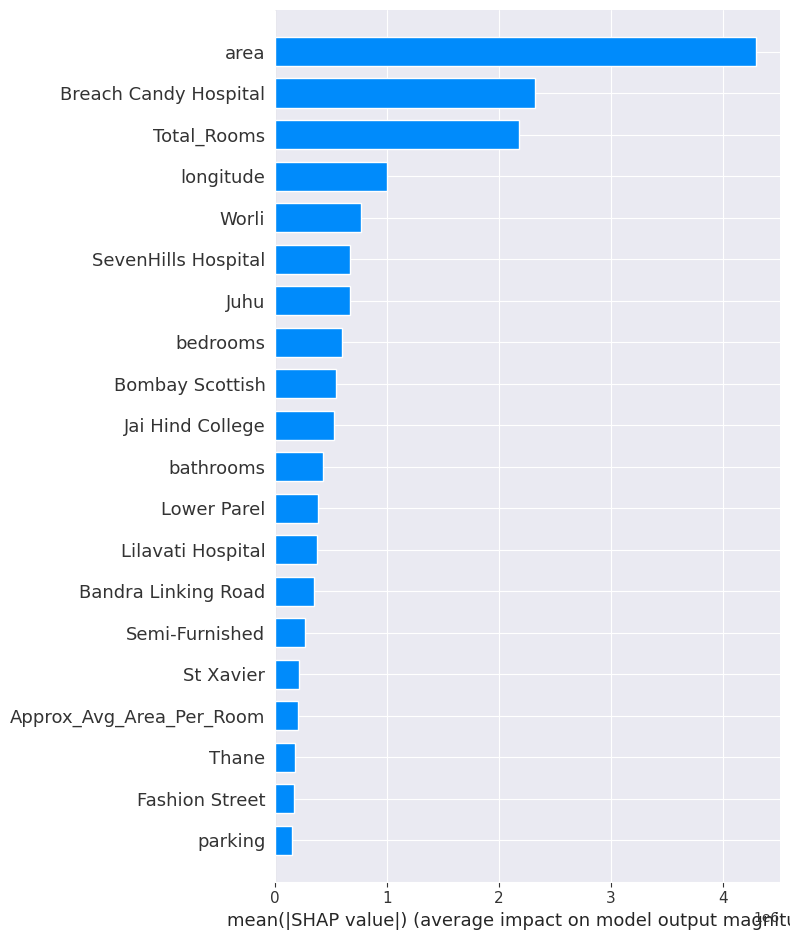

In [ ]:
shap.summary_plot(shap_values, X_train_trf, feature_names=features, plot_type='bar')

## Visualization 2: Shap Summary Plot

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


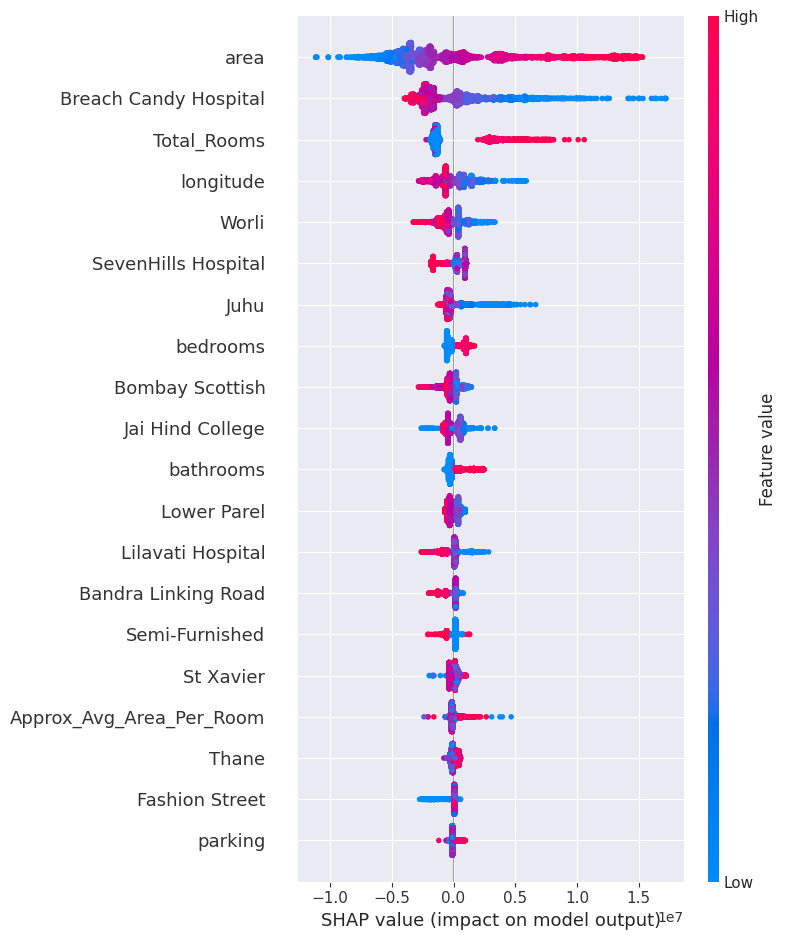

In [ ]:
shap.summary_plot(shap_values, X_train_trf, feature_names=features)

## Visualization 3: Shap Depedance Plot

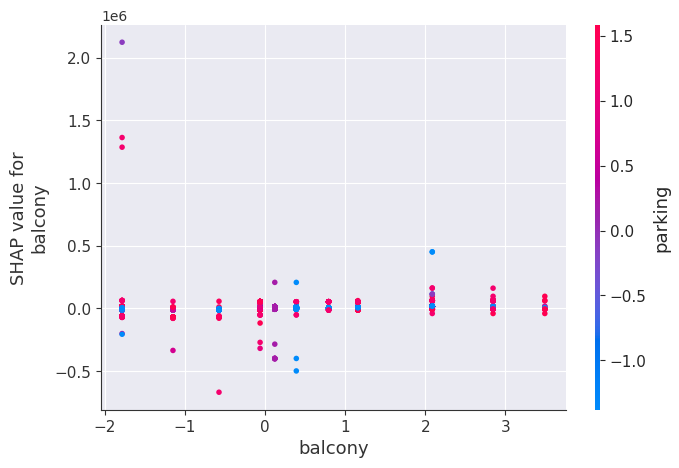

In [ ]:
feature_idx = 0
shap.dependence_plot(feature_idx, shap_values, X_train_trf, feature_names=features)

## Visualization 4: Shap Force Plot

In [ ]:
shap.initjs()

instance_idx = 0
shap.plots.force(explainer.expected_value, shap_values[instance_idx], X_train_trf[instance_idx], feature_names = features)

## Visualization 5: Shap Decision Plot

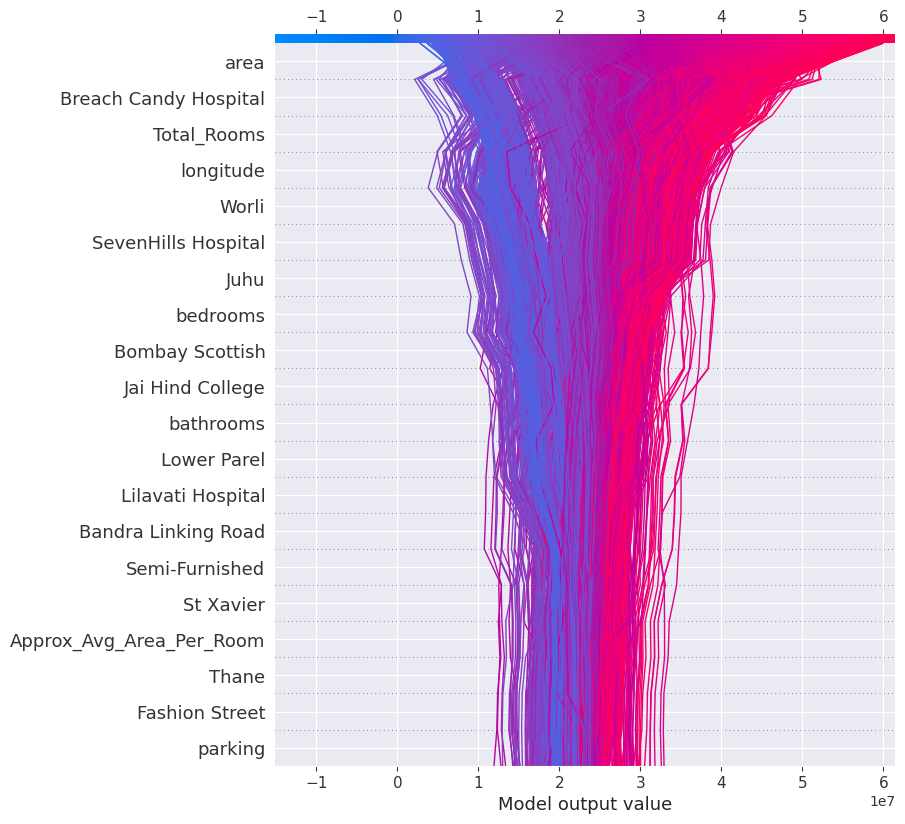

In [ ]:
shap.plots.decision(explainer.expected_value, explainer.shap_values(X_train_trf), feature_order='importance', feature_names = features, ignore_warnings=True)

## Visualization 6: Shap Force Plot

In [ ]:
# visualize the first 5 predictions explanations with a dark red dark blue color map.
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0:5,:], X_train_trf[0:5,:], plot_cmap="DrDb", feature_names=features)

In [ ]:
shap.plots.heatmap(shap_values[:1000])

# HyperParameter Tuning Using Optuna

In [ ]:
!pip install optuna

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 404.2/404.2 kB 3.8 MB/s eta 0:00:00


In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

step1 = ColumnTransformer([
    ('ordinal_encoder', OrdinalEncoder(categories=[['Resale', 'New Property']]), [6])
], remainder='passthrough')

step2 = ColumnTransformer([
    ('ohe_encoder', OneHotEncoder(drop='first', sparse_output=False), [8, 10])
], remainder='passthrough')

step3 = ColumnTransformer([
    ('scaler', RobustScaler(), list(range(5, 60)))
], remainder='passthrough')

step4 = ColumnTransformer([
    ('knn_imputer', KNNImputer(n_neighbors=3, weights='distance'), [5, 6, 7, 10])
], remainder='passthrough')

step5 = ColumnTransformer([
    ('power_transform', PowerTransformer(method='yeo-johnson'), list(range(0, 60)))
], remainder='passthrough')


pipe = Pipeline([
    ('step1', step1),
    ('step2', step2),
    ('step3', step3),
    ('step4', step4),
    ('step5', step5),
])

X_train_trf = pipe.fit_transform(X_train, y_train)
X_test_trf = pipe.transform(X_test)

In [ ]:
import optuna
def objective(trial):
    param = {
        'max_depth': trial.suggest_int('max_depth', 1, 10),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 1.0),
        'n_estimators': trial.suggest_int('n_estimators', 50, 1000),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 10),
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 10),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'max_features': trial.suggest_float('max_features', 0.1, 1.0),
        'alpha': trial.suggest_float('alpha', 0.01, 1.0),
    }
    model = GradientBoostingRegressor(**param)
    kfold = KFold(n_splits=10, shuffle=True, random_state=42)
    score = cross_val_score(model, X_train_trf, y_train, cv=kfold, scoring='r2').mean()
    return score

study = optuna.create_study(direction="maximize", study_name="regression")
study.optimize(objective, n_trials=10)
trial = study.best_trial
print("Best Score:", trial.value)
print("Best Params:")
for key, value in trial.params.items():
    print("  {}: {}".format(key, value))

[I 2023-08-16 16:53:56,160] A new study created in memory with name: regression
[I 2023-08-16 16:54:23,310] Trial 0 finished with value: 0.48390776661914314 and parameters: {'max_depth': 7, 'learning_rate': 0.689399245701308, 'n_estimators': 269, 'min_samples_split': 5, 'min_samples_leaf': 6, 'subsample': 0.3843982862666637, 'max_features': 0.13907981091975896, 'alpha': 0.42854948606712034}. Best is trial 0 with value: 0.48390776661914314.
[I 2023-08-16 16:55:36,209] Trial 1 finished with value: 0.7491907267450135 and parameters: {'max_depth': 7, 'learning_rate': 0.677952589210209, 'n_estimators': 470, 'min_samples_split': 10, 'min_samples_leaf': 9, 'subsample': 0.9233006389637144, 'max_features': 0.12708421361868172, 'alpha': 0.5059927146586839}. Best is trial 1 with value: 0.7491907267450135.
[I 2023-08-16 16:59:15,801] Trial 2 finished with value: 0.6412280163348039 and parameters: {'max_depth': 8, 'learning_rate': 0.7397001410886209, 'n_estimators': 671, 'min_samples_split': 3, 'mi

Best Score: 0.7692879883686382
Best Params:
  max_depth: 8
  learning_rate: 0.40879878447497636
  n_estimators: 807
  min_samples_split: 9
  min_samples_leaf: 7
  subsample: 0.7433722037954684
  max_features: 0.6538785541124312
  alpha: 0.36434181881252864


## Visualization 1: Optimization History Plot

In [ ]:
optuna.visualization.plot_optimization_history(study)

## Visualization 2: Parallel Coordinate Plot

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=["max_depth", "learning_rate", "n_estimators"])

## Visualization 3: Hyperparameter Importance Plot

In [ ]:
optuna.visualization.plot_param_importances(study)

## Visualization 4: Scatter Plot of Objective Values

In [ ]:
optuna.visualization.plot_contour(study)

## Visualization 5: Parameter Distribution Plots

In [ ]:
optuna.visualization.plot_slice(study, params=["max_depth", "learning_rate"])

## Visualization 6: Hyperparameter Correlation Heatmap

<ipython-input-147-09f541a14cce>:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



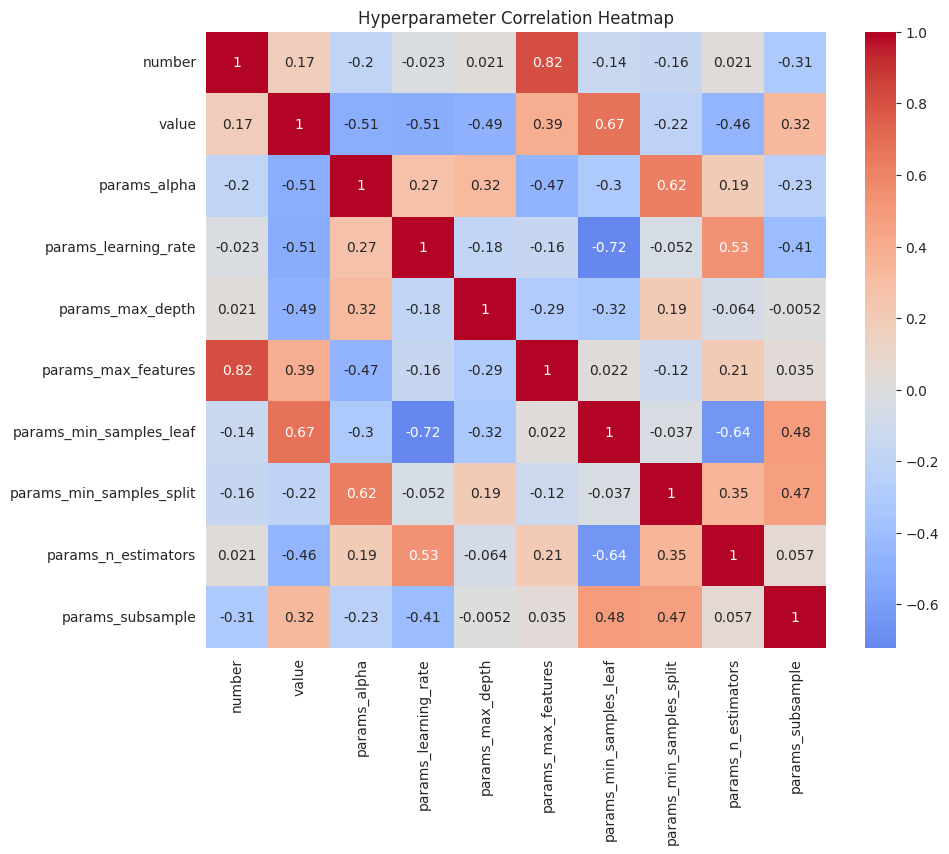

In [ ]:
df = study.trials_dataframe()
correlation_matrix = df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", center=0)
plt.title("Hyperparameter Correlation Heatmap")
plt.show()

## Visualization 7: Convergence Plot

In [ ]:
optuna.visualization.plot_intermediate_values(study)

[W 2023-08-16 17:35:50,019] You need to set up the pruning feature to utilize `plot_intermediate_values()`
